In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [2]:
import sys
import os
sys.path.append("src/")
sys.path.append("src/diffusers/")

# make sure you're logged in with `huggingface-cli login`
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, LMSDiscreteScheduler, DDIMScheduler, PNDMScheduler
import numpy as np
import imageio
import torchvision.transforms as T

to_pil = T.ToPILImage()

os.makedirs("stable_outs", exist_ok=True)
schedulers = [LMSDiscreteScheduler, DDIMScheduler, PNDMScheduler]
lms = schedulers[0](
    beta_start=0.00085, 
    beta_end=0.012, 
    beta_schedule="scaled_linear"
)

pipe = StableDiffusionPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4", 
    scheduler=lms,
    use_auth_token=True,
    revision="fp16",
    torch_dtype=torch.float16,
).to("cuda")

def pathify_prompt(prompt):
    return prompt.replace(" ", "_").replace(",", "")

def save_image(image, prompt):
    path = f"stable_outs/{pathify_prompt(prompt)}.jpg"
    image.save(path, quality=95, subsample=False)

In [3]:
def sample_from_cv2(sample: np.ndarray) -> torch.Tensor:
    sample = ((sample.astype(float) / 255.0) * 2) - 1
    sample = sample[None].transpose(0, 3, 1, 2).astype(np.float16)
    sample = torch.from_numpy(sample).float().clip(0, 1)
    return sample


def sample_to_cv2(sample: torch.Tensor) -> np.ndarray:
    from einops import rearrange
    sample_f32 = rearrange(sample.squeeze().cpu().numpy(), "c h w -> h w c").astype(np.float32)
    sample_f32 = ((sample_f32 * 0.5) + 0.5).clip(0, 1)
    sample_int8 = (sample_f32 * 255).astype(np.uint8)
    return sample_int8


def maintain_colors(prev_img, color_match_sample, hsv=False, lab=False, pil_input=False):
    from skimage.exposure import match_histograms
    import cv2
    if pil_input:
        prev_img = torch.tensor(np.array(prev_img)).permute(2, 0, 1).unsqueeze(0) / 255
        color_match_sample = torch.tensor(np.array(color_match_sample)).permute(2, 0, 1).unsqueeze(0) / 255
    prev_img = sample_to_cv2(prev_img)
    color_match_sample = sample_to_cv2(color_match_sample)
    if hsv:
        prev_img_hsv = cv2.cvtColor(prev_img, cv2.COLOR_RGB2HSV)
        color_match_hsv = cv2.cvtColor(color_match_sample, cv2.COLOR_RGB2HSV)
        matched_hsv = match_histograms(prev_img_hsv, color_match_hsv, multichannel=True)
        img = cv2.cvtColor(matched_hsv, cv2.COLOR_HSV2RGB)
    elif lab:
        prev_img_lab = cv2.cvtColor(prev_img, cv2.COLOR_RGB2LAB)
        color_match_lab = cv2.cvtColor(color_match_sample, cv2.COLOR_RGB2LAB)
        matched_lab = match_histograms(prev_img_lab, color_match_lab, multichannel=True)
        img = cv2.cvtColor(matched_lab, cv2.COLOR_LAB2RGB)    
    else:
        img = match_histograms(prev_img, color_match_sample, multichannel=True)
    img = sample_from_cv2(img)
    return img

In [4]:
320 / 64

5.0

In [5]:
64 * 6

384

In [9]:
16 / 9

1.7777777777777777

In [10]:
1920 / 64

30.0

In [14]:
1088 / 64

17.0

In [17]:
1920 / 4

480.0

In [16]:
1088 / 4

272.0

In [10]:
14 / 8

1.75

In [11]:
prompt = "An ancient dream starts to calm down. It is quiet and peaceful. A stunning painting by Anton Wiehe and Salvador Dali"

#width = 64 * 12
#height = 64 * 8

# max - 20 or 21 * 64 on both sides

width = 14 * 64
height = 7 * 64

print(width, height)

with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=50,
                       guidance_scale=7, seed=1,
                        width=width, height=height,
              )
    alien_latent = out["images"][0]     
    with torch.inference_mode():
        alien_image = pipe.decode_image(alien_latent.unsqueeze(0), output_type="torch")[0]
to_pil(alien_image).show()
alien_latent.mean(), alien_latent.std()#, ContrastLoss()(alien_image)

896 512


0it [00:00, ?it/s]


RuntimeError: CUDA out of memory. Tried to allocate 1.53 GiB (GPU 0; 10.76 GiB total capacity; 7.24 GiB already allocated; 420.56 MiB free; 9.38 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [3]:
pipe.to("cpu")
vae = pipe.vae.cuda()
#pil_imgs = imagine.decode_image(latents, output_type="pil", device="cuda")

In [4]:
import torch

def decode(batch_size=1):
    rand_latent = torch.randn(batch_size, 4, 64, 64).cuda()
    pipe.vae.decode(rand_latent)
    #out = pipe.decode_image(rand_latent, output_type="pil", device="cuda")[0]

In [5]:
torch.cuda.empty_cache()

In [6]:
#with autocast("cuda"):
#        with torch.inference_mode():
#            %timeit decode(1)

In [7]:
pipe = pipe.to("cuda")

0it [00:00, ?it/s]

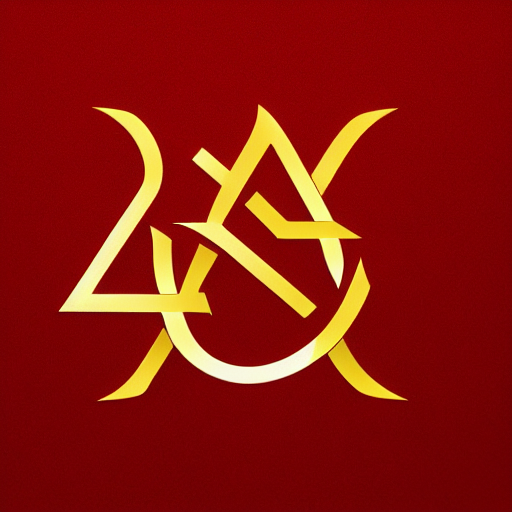

0it [00:00, ?it/s]

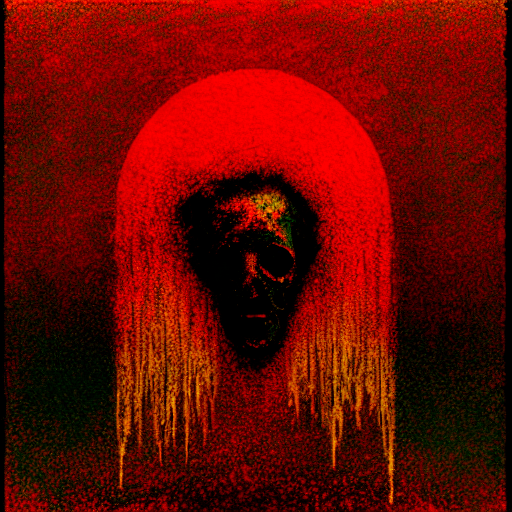

0it [00:00, ?it/s]

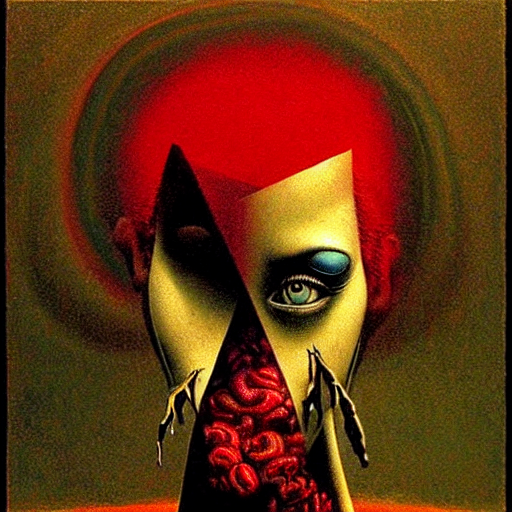

In [12]:
prompts = ["Plazma. Stunning logo, 4K", "Plazma Punk. Stunning anarchist logo in the style of Beksinski, Dali, Monet. 4K",
          "Punk fusing into plazma. Stunning logo in the style of Dali, Beksinski"]
for prompt in prompts:
    with autocast("cuda"):
        out = pipe(prompt, output_type="latent",  num_inference_steps=50,
                           guidance_scale=12, seed=1,
                            width=512, height=512,
                  )
        alien_latent = out["sample"][0]     
        with torch.inference_mode():
            alien_image = pipe.decode_image(alien_latent.unsqueeze(0), output_type="torch")[0]
    to_pil(alien_image).show()
    alien_latent.mean(), alien_latent.std()#, ContrastLoss()(alien_image)

In [5]:
out.keys()

odict_keys(['images', 'nsfw_content_detected'])

In [8]:
alien_latent.shape

torch.Size([4, 64, 64])

In [8]:
with autocast("cuda"):
    with torch.inference_mode():
        latents = alien_latent.unsqueeze(0) / 0.18215
        image = pipe.vae.decode(latents.to("cuda"
                                          ))["sample"]
        image = (image / 2 + 0.5).clamp(0, 1)
        image = image.cpu()

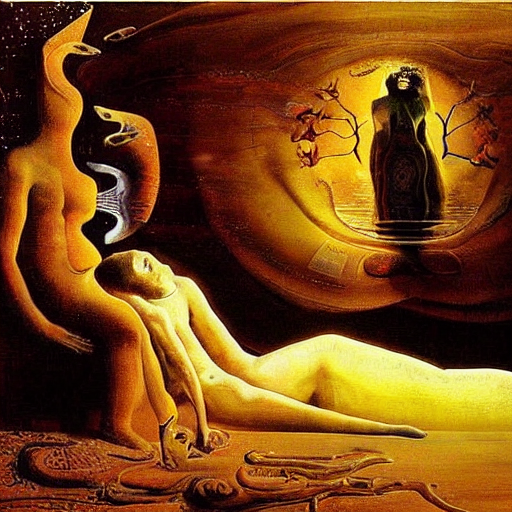

In [9]:
to_pil(image.squeeze())

In [10]:
680 / 8

85.0

0it [00:00, ?it/s]


RuntimeError: Sizes of tensors must match except in dimension 1. Expected size 44 but got size 43 for tensor number 1 in the list.

In [7]:
prompt = "An ancient dream starts to calm down. It is quiet and peaceful. A stunning painting by Anton Wiehe and Salvador Dali"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=50,
                       guidance_scale=7, seed=1,
                        width=512, height=512,
              )
    alien_latent = out["sample"][0]     
    with torch.inference_mode():
        alien_image = pipe.decode_image(alien_latent.unsqueeze(0), output_type="torch")[0]
to_pil(alien_image).show()
alien_latent.mean(), alien_latent.std()#, ContrastLoss()(alien_image)

NameError: name 'tqdm' is not defined

0it [00:00, ?it/s]

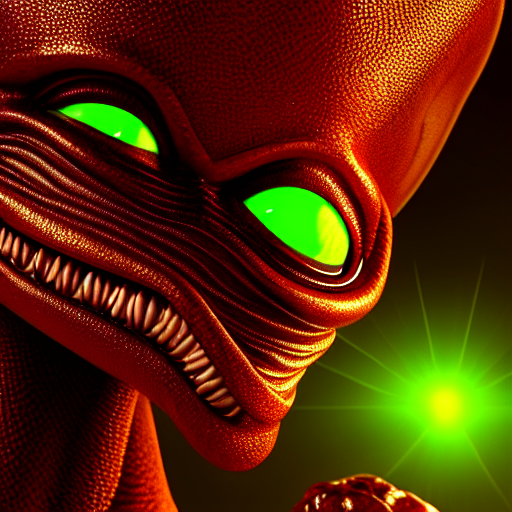

(tensor(-0.1350), tensor(1.0694))

In [4]:
prompt = "The alien (4K resolution)"#. Contest-winning Masterpiece (4K)"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=20,
                       guidance_scale=12, seed=1,
                        width=512, height=512,
              )
    alien_latent = out["sample"][0]     
    with torch.inference_mode():
        alien_image = pipe.decode_image(alien_latent.unsqueeze(0), output_type="torch")[0]
to_pil(alien_image).show()
alien_latent.mean(), alien_latent.std()#, ContrastLoss()(alien_image)

In [7]:
import sys
sys.path.append("src")
from diffusers.callbacks import create_callbacks, ContrastLoss

callbacks = create_callbacks(use_lpips=True, lpips_image=alien_image, 
                             lpips_lr=0, lpips_frequency=5)

Setting up [LPIPS] perceptual loss: trunk [squeeze], v[0.1], spatial [off]
Loading model from: /srv/home/8wiehe/.local/lib/python3.8/site-packages/lpips/weights/v0.1/squeeze.pth


/srv/home/8wiehe/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/srv/home/8wiehe/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=SqueezeNet1_1_Weights.IMAGENET1K_V1`. You can also use `weights=SqueezeNet1_1_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


0it [00:00, ?it/s]

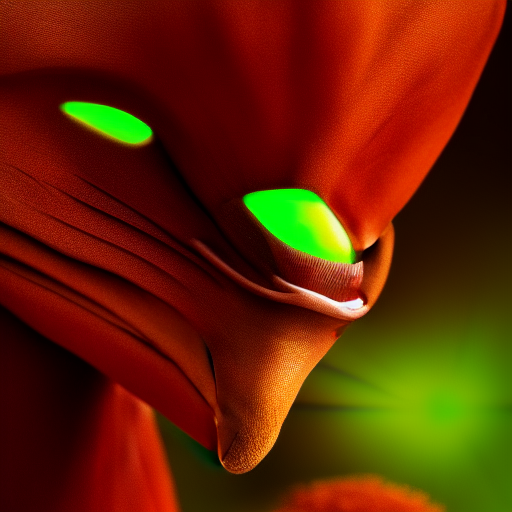

NameError: name 'ContrastLoss' is not defined

In [15]:
prompt = "A dodo bird in the forest. 4K nature photography"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=8,
                       guidance_scale=7, seed=10,
                        width=512, height=512,
                        #loss_callbacks=callbacks,
                        start_img=alien_image,
                        img2img_strength=0.6,
                       #noise_steps=900,
                       #t_start=900,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
masterpiece_latent.mean(), masterpiece_latent.std(), ContrastLoss()(fairy_image)

In [8]:
prompt = "A dodo bird in the forest. 4K nature photography"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=1000,
                       guidance_scale=12, seed=10,
                        width=512, height=512,
                        #loss_callbacks=callbacks,
                        start_img=alien_image,
                        #img2img_strength=0.6,
                       noise_steps=900,
                       #t_start=900,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
masterpiece_latent.mean(), masterpiece_latent.std(), ContrastLoss()(fairy_image)

0it [00:00, ?it/s]

KeyboardInterrupt: 

In [102]:
pipe.scheduler.timesteps

tensor([999.0000, 978.6122, 958.2245, 937.8367, 917.4490, 897.0612, 876.6735,
        856.2857, 835.8980, 815.5102, 795.1224, 774.7347, 754.3469, 733.9592,
        713.5714, 693.1837, 672.7959, 652.4082, 632.0204, 611.6327, 591.2449,
        570.8571, 550.4694, 530.0816, 509.6939, 489.3061, 468.9184, 448.5306,
        428.1429, 407.7551, 387.3673, 366.9796, 346.5918, 326.2041, 305.8163,
        285.4286, 265.0408, 244.6531, 224.2653, 203.8776, 183.4898, 163.1020,
        142.7143, 122.3265, 101.9388,  81.5510,  61.1633,  40.7755,  20.3878,
          0.0000], dtype=torch.float64)

In [157]:
pipe.scheduler.sigmas

tensor([14.6147, 14.4384, 14.2648, 14.0937, 13.9252, 13.7592, 13.5956, 13.4344,
        13.2755, 13.1190, 12.9648, 12.8128, 12.6631, 12.5155, 12.3700, 12.2266,
        12.0853, 11.9461, 11.8088, 11.6735, 11.5401, 11.4087, 11.2791, 11.1513,
        11.0253, 10.9012, 10.7787, 10.6580, 10.5390, 10.4217, 10.3060, 10.1919,
        10.0794,  9.9684,  9.8590,  9.7511,  9.6447,  9.5397,  9.4362,  9.3341,
         9.2334,  9.1341,  9.0361,  8.9395,  8.8441,  8.7501,  8.6573,  8.5658,
         8.4755,  8.3864,  8.2985,  8.2117,  8.1261,  8.0417,  7.9583,  7.8761,
         7.7950,  7.7149,  7.6358,  7.5578,  7.4808,  7.4049,  7.3299,  7.2558,
         7.1828,  7.1107,  7.0395,  6.9692,  6.8998,  6.8313,  6.7637,  6.6969,
         6.6310,  6.5659,  6.5017,  6.4382,  6.3756,  6.3137,  6.2526,  6.1923,
         6.1327,  6.0739,  6.0158,  5.9584,  5.9017,  5.8457,  5.7904,  5.7358,
         5.6819,  5.6286,  5.5759,  5.5239,  5.4726,  5.4218,  5.3717,  5.3221,
         5.2732,  5.2248,  5.1770,  5.12

In [27]:
img2img_strength = 0.8
num_inference_steps = 50

batch_size = 1
offset = 0
num_inference_steps = int(np.ceil(num_inference_steps / img2img_strength))
# set schedule again according to updated steps
pipe.scheduler.set_timesteps(num_inference_steps)
# now we calculate how many skeps are skipped (t_start) and at what point the noise is initialized (init_timestep)
init_timestep = int(num_inference_steps * img2img_strength) + offset
t_start = num_inference_steps - init_timestep + offset
#print("init_timestep:", init_timestep, "t_start: ", t_start)
timesteps = int(pipe.scheduler.timesteps[t_start])
timesteps = torch.tensor([timesteps] * batch_size, dtype=torch.long, device=pipe.device)

In [28]:
timesteps

tensor([789], device='cuda:0')

In [29]:
t_start

13

tensor(4.8742, dtype=torch.float64) tensor(4.9757, dtype=torch.float64)


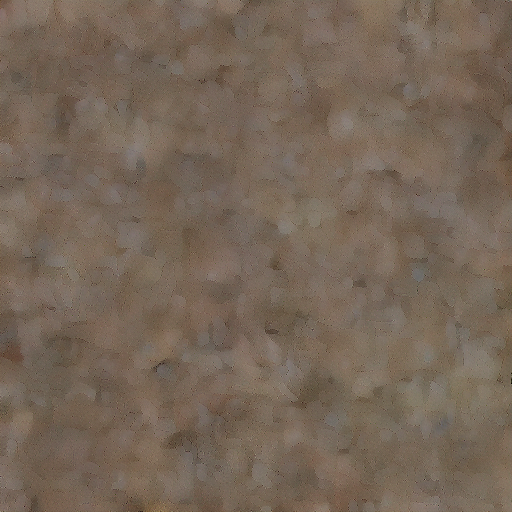

In [30]:
#timestep = int(pipe.scheduler.timesteps[-t_start])

with autocast("cuda"):
    with torch.inference_mode():
        sigma = pipe.scheduler.sigmas[t_start]
        print(sigma, ((sigma**2 + 1) ** 0.5))
        
        image_embed = pipe.encode_image(alien_image)

        noise = torch.randn_like(image_embed)
        image_embed = pipe.scheduler.add_noise(image_embed, noise, timesteps)
        
        # multiply by sigma
        #image_embed = image_embed * sigma
                
        image_embed = image_embed / ((sigma**2 + 1) ** 0.5)
        
        out = pipe.decode_image(image_embed)[0]
out.show()

193
tensor(0.5559, dtype=torch.float64) tensor(1.1441, dtype=torch.float64)


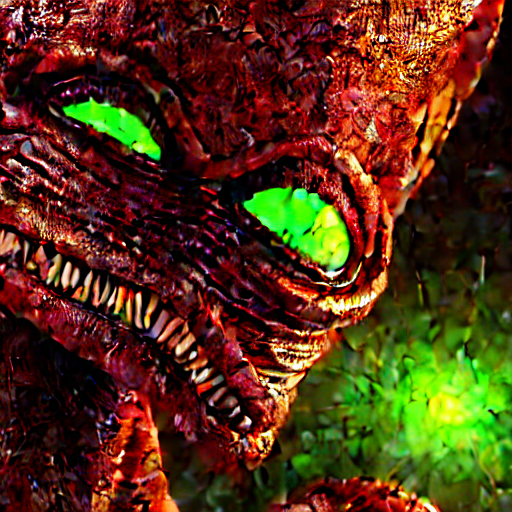

In [31]:
t_start = 50

timestep = int(pipe.scheduler.timesteps[t_start])
print(timestep)

with autocast("cuda"):
    with torch.inference_mode():
        sigma = pipe.scheduler.sigmas[t_start]
        print(sigma, ((sigma**2 + 1) ** 0.5))
        
        image_embed = pipe.encode_image(alien_image)

        noise = torch.randn_like(image_embed)
        image_embed = pipe.scheduler.add_noise(image_embed, noise, timestep)
        
        
        # multiply by sigma
        image_embed = image_embed * ((sigma**2 + 1) ** 0.5)
        
        #
        image_embed = image_embed / ((sigma**2 + 1) ** 0.5)
        
        out = pipe.decode_image(image_embed)[0]
out.show()

0it [00:00, ?it/s]

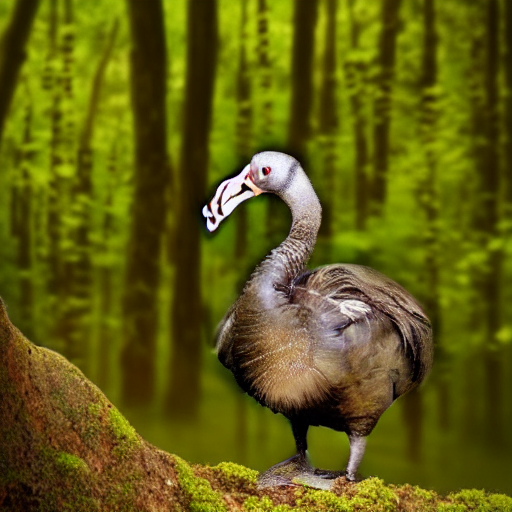

(tensor(0.4025), tensor(0.9095))

In [312]:
prompt = "A dodo bird in the forest. 4K nature photography"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=22,
                       guidance_scale=12, seed=10,
                        width=512, height=512,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
masterpiece_latent.mean(), masterpiece_latent.std()#, ContrastLoss()(fairy_image)

0it [00:00, ?it/s]

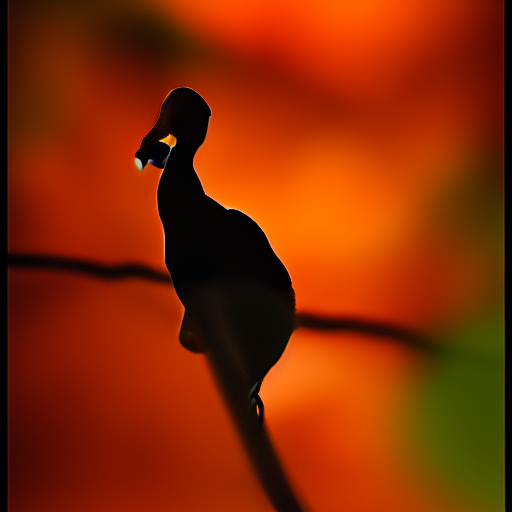

(tensor(0.0218), tensor(1.0108), tensor(0.1390, dtype=torch.float16))

0it [00:00, ?it/s]

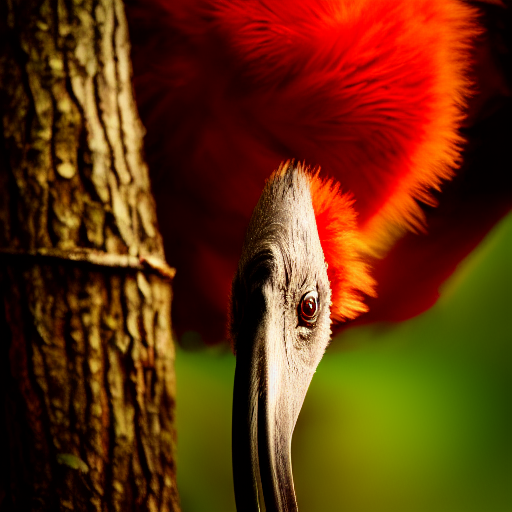

(tensor(0.0198), tensor(1.0930), tensor(0.2281, dtype=torch.float16))

In [15]:
prompt = "A dodo bird in the forest. 4K nature photography"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=50,
                       guidance_scale=12, seed=10,
                        width=512, height=512,
                        #loss_callbacks=callbacks,
                        start_img=alien_image,
                        img2img_strength=0.9,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
masterpiece_latent.mean(), masterpiece_latent.std(), ContrastLoss()(fairy_image)

In [16]:
prompt = "A dodo bird in the forest. 4K nature photography"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=20,
                       guidance_scale=12, seed=20,
                        width=512, height=512,
                        loss_callbacks=callbacks,
                       start_img=alien_image,
                       img2img_strength=0.8,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
masterpiece_latent.mean(), masterpiece_latent.std(), ContrastLoss()(fairy_image)

NameError: name 'callbacks' is not defined

0it [00:00, ?it/s]

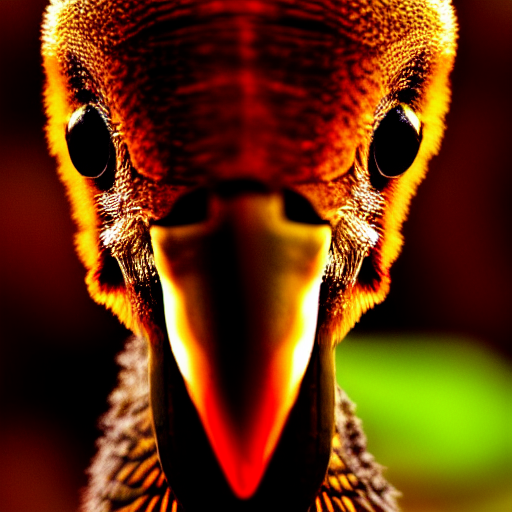

(tensor(-0.1029), tensor(1.1687), tensor(0.2573, dtype=torch.float16))

In [17]:
prompt = "A dodo bird in the forest. 4K nature photography"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=20,
                       guidance_scale=12, seed=1,
                        width=512, height=512,
                        #loss_callbacks=callbacks,
                       start_img=alien_image,
                       img2img_strength=0.8,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
masterpiece_latent.mean(), masterpiece_latent.std(), ContrastLoss()(fairy_image)

0it [00:00, ?it/s]

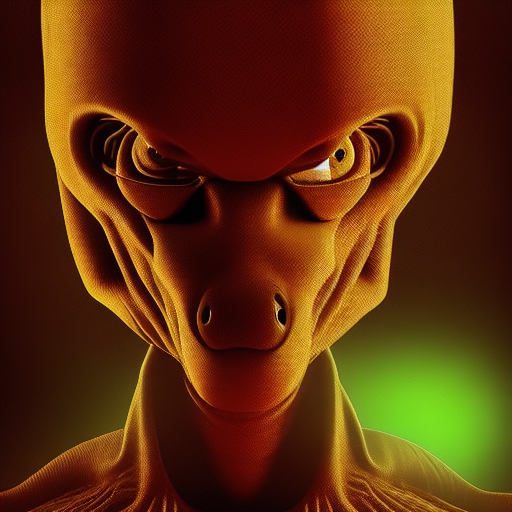

(tensor(-0.1126), tensor(0.8365), tensor(0.1670, dtype=torch.float16))

In [18]:
prompt = "A dodo bird in the forest. 4K nature photography"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=200,
                       guidance_scale=12, seed=1,
                        width=512, height=512,
                        #loss_callbacks=callbacks,
                       start_img=alien_image,
                       img2img_strength=0.4,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
masterpiece_latent.mean(), masterpiece_latent.std(), ContrastLoss()(fairy_image)

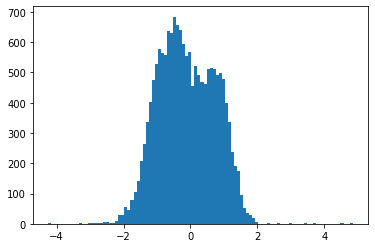

In [19]:
import matplotlib.pyplot as plt

p = plt.hist(masterpiece_latent.cpu().flatten().numpy(), bins=100)

0it [00:00, ?it/s]

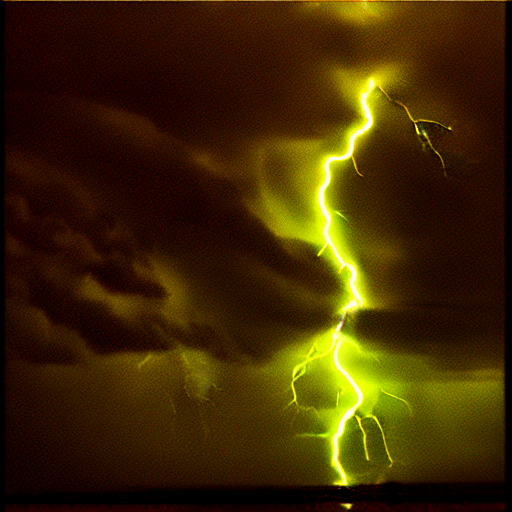

(tensor(-0.0647), tensor(1.0271))

In [20]:
prompt = "There is a sound of thunder echoing through the quiet darkness. It feels happy"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  
               num_inference_steps=10,
                       guidance_scale=15, seed=1,
                        width=512, height=512,
                       #loss_callbacks=callbacks,
              )
    ass_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
ass_latent.mean(), ass_latent.std()#, ContrastLoss()(fairy_image)

0it [00:00, ?it/s]

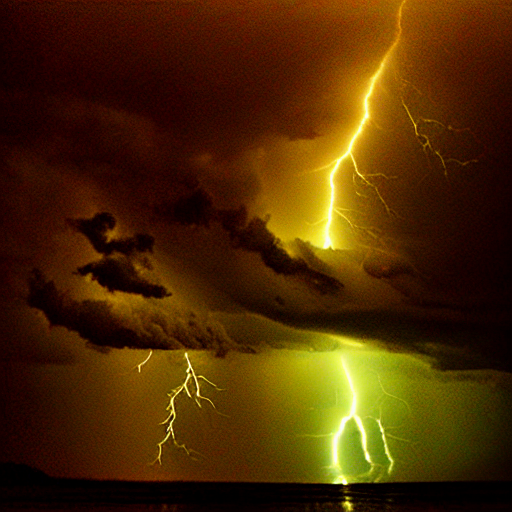

(tensor(-0.0305), tensor(0.9965))

In [21]:
prompt = "There is a sound of thunder echoing through the quiet darkness. Happy"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  
               num_inference_steps=50,
                       guidance_scale=15, seed=1,
                        width=512, height=512,
                       #loss_callbacks=callbacks,
              )
    ass_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
ass_latent.mean(), ass_latent.std()#, ContrastLoss()(fairy_image)

0it [00:00, ?it/s]

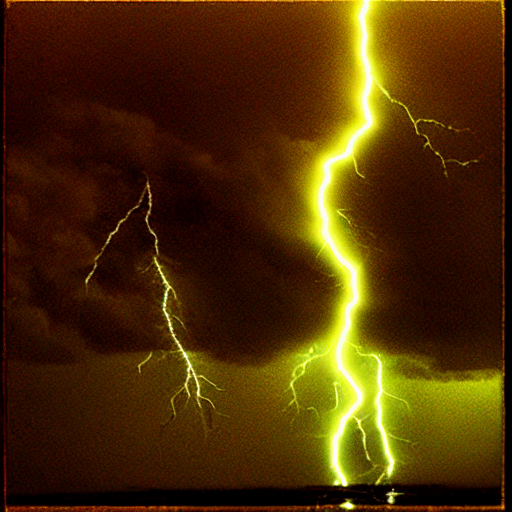

(tensor(-0.0340), tensor(0.9821))

In [22]:
prompt = "There is a sound of thunder echoing through the quiet darkness."
prompt_2 = "It feels happy"

embed = torch.lerp(pipe.embed_prompts([prompt]), pipe.embed_prompts([prompt_2]), 0.1)

with autocast("cuda"):
    out = pipe(text_embeddings=embed, output_type="latent",  
               num_inference_steps=50,
                       guidance_scale=15, seed=1,
                        width=512, height=512,
                       #loss_callbacks=callbacks,
              )
    ass_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
ass_latent.mean(), ass_latent.std()#, ContrastLoss()(fairy_image)

0it [00:00, ?it/s]

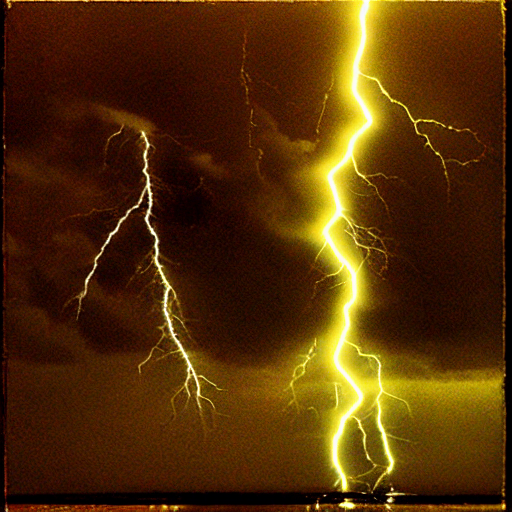

(tensor(-0.0483), tensor(0.9255))

In [23]:
prompt = "There is a sound of thunder echoing through the quiet darkness."
prompt_2 = "happy"

embed = torch.lerp(pipe.embed_prompts([prompt]), pipe.embed_prompts([prompt_2]), 0.2)

with autocast("cuda"):
    out = pipe(text_embeddings=embed, output_type="latent",  
               num_inference_steps=50,
                       guidance_scale=15, seed=1,
                        width=512, height=512,
                       #loss_callbacks=callbacks,
              )
    ass_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
ass_latent.mean(), ass_latent.std()#, ContrastLoss()(fairy_image)

0it [00:00, ?it/s]

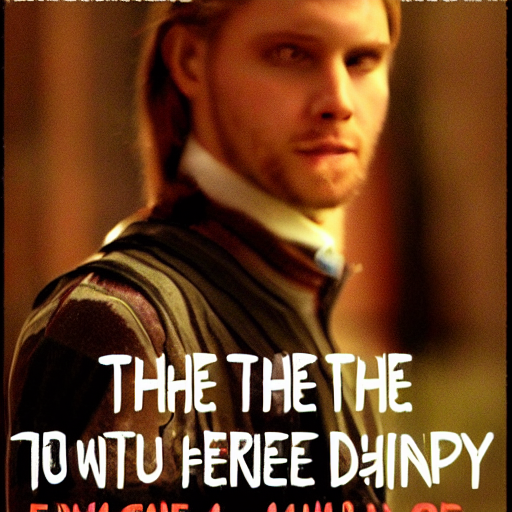

(tensor(-0.0605), tensor(0.8826))

In [24]:
prompt = "There is a sound of thunder echoing through the quiet darkness."
prompt_2 = "Happy"

embed = torch.lerp(pipe.embed_prompts([prompt]), pipe.embed_prompts([prompt_2]), 0.5)

with autocast("cuda"):
    out = pipe(text_embeddings=embed, output_type="latent",  
               num_inference_steps=50,
                       guidance_scale=15, seed=1,
                        width=512, height=512,
                       #loss_callbacks=callbacks,
              )
    ass_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
ass_latent.mean(), ass_latent.std()#, ContrastLoss()(fairy_image)

In [25]:
import sys
sys.path.append("../mus2vid")
from mus2vid.math_utils import slerp, norm

In [26]:
def slerp_latent(a, b, frac):
    # only works on single latents atm
    a = a.squeeze()
    b = b.squeeze()
    assert a.ndim == 2
    # if we do slerping directly we apply it to all tokens. Instead, apply slerp to each token individually
    slerped = [a[0].unsqueeze(0)]
    for i in range(1, len(a)):
        slerped_token = slerp(a[i].unsqueeze(0), b[i].unsqueeze(0), frac)
        slerped.append(slerped_token)
    return torch.cat(slerped).unsqueeze(0)

0it [00:00, ?it/s]

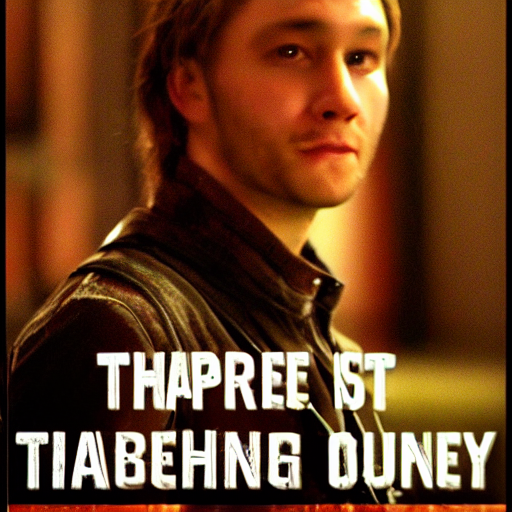

(tensor(-0.0559), tensor(0.9126))

In [28]:
prompt = "There is a sound of thunder echoing through the quiet darkness."
prompt_2 = "Happy"

embed_1 = pipe.embed_prompts([prompt])
embed_2 = pipe.embed_prompts([prompt_2])

embed = slerp_latent(embed_1, embed_2, 0.5)

with autocast("cuda"):
    out = pipe(text_embeddings=embed, output_type="latent",  
               num_inference_steps=50,
                       guidance_scale=15, seed=1,
                        width=512, height=512,
                       #loss_callbacks=callbacks,
              )
    ass_latent = out["sample"][0]     
    with torch.inference_mode():
        fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image).show()
ass_latent.mean(), ass_latent.std()#, ContrastLoss()(fairy_image)

In [29]:
with torch.inference_mode():
    with autocast("cuda"):
        embed_1 = pipe.embed_prompts([prompt])
        embed_2 = pipe.embed_prompts([prompt_2])
        embed = torch.lerp(embed_1, embed_2, 0.3)
        #embed[:, 2, :] = 0

0it [00:00, ?it/s]

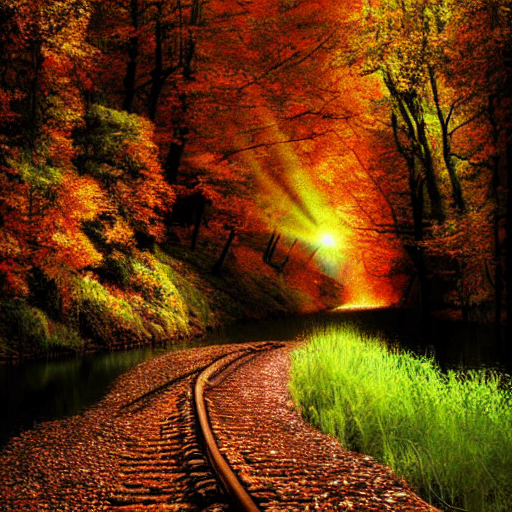

0it [00:00, ?it/s]

KeyboardInterrupt: 

In [30]:
prompt = "Award-winning photo"
prompt_2 =  "Award-winning photo. It feels happy"

with torch.inference_mode():
    with autocast("cuda"):
        for w in torch.linspace(0, 1, 10).cuda():
            embed_1 = pipe.embed_prompts([prompt])
            embed_2 = pipe.embed_prompts([prompt_2])
            embed = torch.lerp(embed_1, embed_2, w)

            out = pipe(text_embeddings=embed, output_type="latent",  
                       num_inference_steps=50,
                               guidance_scale=15, seed=1,
                                width=512, height=512,
                               #loss_callbacks=callbacks,
                      )
            ass_latent = out["sample"][0]     

            fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
            to_pil(fairy_image).show()


In [ ]:
prompt = "Award-winning photo"
prompt_2 =  "Sad. Award-winning photo"

with torch.inference_mode():
    with autocast("cuda"):
        for w in torch.linspace(0, 1, 10).cuda():
            embed_1 = pipe.embed_prompts([prompt])
            embed_2 = pipe.embed_prompts([prompt_2])
            embed = torch.lerp(embed_1, embed_2, w)

            out = pipe(text_embeddings=embed, output_type="latent",  
                       num_inference_steps=50,
                               guidance_scale=15, seed=1,
                                width=512, height=512,
                               #loss_callbacks=callbacks,
                      )
            ass_latent = out["sample"][0]     

            fairy_image = pipe.decode_image(ass_latent.unsqueeze(0), output_type="torch")[0]
            to_pil(fairy_image).show()


In [ ]:
torch.cuda.empty_cach()

In [ ]:
# runnb MusToVi.ipynb net=stable_diffusion do_create_gpt_cluster_stories=1 lat_diff_iterate_on_image=1 postfix=" Masterpiece artwork by Anton Wiehe" lat_diff_img2img_strength=0.75 gpu=0 sub_steps=100 num_noise=20

In [ ]:
masterpiece_latent.shape

In [ ]:
# interpolate using slerp
def slerp(low, high, val):
    low_norm = low / torch.norm(low, dim=1, keepdim=True)
    high_norm = high / torch.norm(high, dim=1, keepdim=True)
    epsilon = 1e-7
    omega = (low_norm * high_norm).sum(1)
    omega = torch.acos(torch.clamp(omega, -1 + epsilon, 1 - epsilon))
    so = torch.sin(omega)
    res = (torch.sin((1.0 - val) * omega) / so).unsqueeze(1) * low + (torch.sin(val * omega) / so).unsqueeze(1) * high
    return res

steps = 10

with autocast("cuda"):
    with torch.inference_mode():
        for frac in np.linspace(0, 1, steps):
            interp_latent = slerp(masterpiece_latent, ass_latent, frac)
            pipe.decode_image(interp_latent.unsqueeze(0))[0].show()
            

In [ ]:
# TODO: put interpolations next to each other and make gif!

In [ ]:
prompt = "My ashes befell the ground and became the fundament of a new society. Award-winning photography"#, shot on Canon EOS R6"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent",  num_inference_steps=50,
                       guidance_scale=15, seed=6,
                        width=512, height=512,
                        #loss_callbacks=callbacks,  
                      # start_img=fairy_image.float(),
                       #img2img_strength=0.7,
              )
    masterpiece_latent = out["sample"][0]     
    with torch.inference_mode():
        reg_img = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(reg_img).show()
masterpiece_latent.mean(), masterpiece_latent.std()

In [ ]:
prompt = "My ashes befell the ground and became the fundament of a new society. Masterpiece by Monet and Satan"

reg_img_2 = reg_img

for i in range(100):
    if i == 5:
        prompt = "My ashes befell the ground and became the fundament of a new society. Masterpiece by Monet. Rainbows everywhere!"

    with autocast("cuda"):
        out = pipe(prompt, output_type="latent",  num_inference_steps=1000,
                           guidance_scale=12, seed=i * 10,
                            width=512, height=512,
                            #loss_callbacks=callbacks,  
                           start_img=reg_img_2.float(),
                           #img2img_strength=0.55,
                           noise_steps=20,
                           t_start=980,
                  )
        masterpiece_latent = out["sample"][0]   
        last = reg_img_2
        with torch.inference_mode():
            reg_img_2 = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0].float()
        #reg_img_2 = maintain_colors(reg_img_2, last, lab=1, pil_input=0, hsv=0)
        
    to_pil(reg_img_2.squeeze()).show()
    print(masterpiece_latent.mean(), masterpiece_latent.std())#, ContrastLoss()(reg_img_2))

In [ ]:
import numpy as np
import imageio
import torchvision.transforms as T

to_pil = T.ToPILImage()
prompt = "A fairy is flying with her beautiful wings. Digital Masterpiece"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent", use_safety=False,
                        num_inference_steps=10, eta=0.75, 
                       guidance_scale=12, seed=0,
                        width=512, height=512, start_img=None,
                        )
    masterpiece_latent = out["sample"][0] 
    masterpiece_latent_transition = out["latents"]
    
    with torch.inference_mode():
        fairy_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")[0]
to_pil(fairy_image)

In [ ]:
masterpiece_latent.mean(), masterpiece_latent.std(), masterpiece_latent.shape

In [ ]:
normed_latent = masterpiece_latent.unsqueeze(0)
std = normed_latent.abs().std()
mean = normed_latent.abs().mean()
normed_latent = (normed_latent - mean) / std
with torch.no_grad():
    with autocast("cuda"):
        decoded = pipe.decode_image(normed_latent)[0]
decoded

In [ ]:
#lpips_callback["loss_function"](fairy_image)

In [ ]:
import numpy as np
import imageio

prompt = "A cat eating a burger"

with autocast("cuda"):
    out = pipe(prompt, output_type="latent", use_safety=False,
                        num_inference_steps=20, eta=0.75, 
                       guidance_scale=12, seed=0,
                        width=512, height=512, 
                       start_img=fairy_image.float(),
                       noise_strength_before_encode=0.015,
                       img2img_strength=0.6,
                       loss_callbacks=callbacks,
                        )
    masterpiece_latent = out["sample"][0] 
    masterpiece_latent_transition = out["latents"]
    
    with torch.inference_mode():
        masterpiece_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="pil")[0]
masterpiece_image

In [ ]:
import numpy as np
import imageio

prompt = "A cat eating a burger"

with autocast("cuda"):
    out = pipe(prompt, output_type="latent", use_safety=False,
                        num_inference_steps=20, eta=0.75, 
                       guidance_scale=12, seed=0,
                        width=512, height=512, 
                       start_img=fairy_image.float(),
                       noise_strength_before_encode=0.015,
                       img2img_strength=0.8,
                       #loss_callbacks=callbacks,
                        )
    masterpiece_latent = out["sample"][0] 
    masterpiece_latent_transition = out["latents"]
    
    with torch.inference_mode():
        masterpiece_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="pil")[0]
masterpiece_image

0it [00:00, ?it/s]

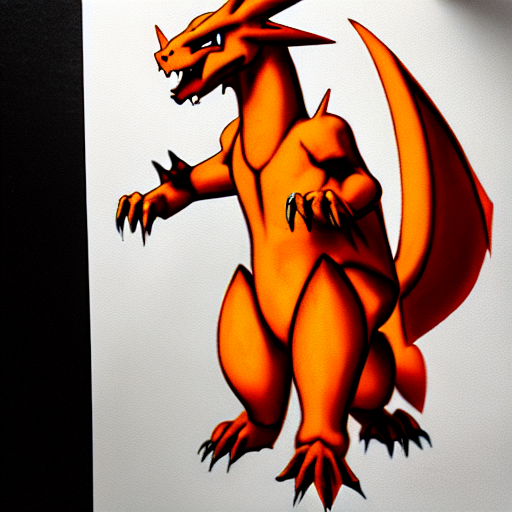

In [252]:
import numpy as np
import imageio

prompt = "Charizard Masterpiece by RJ Palmer"

with autocast("cuda"):
    out = pipe(prompt, output_type="latent", use_safety=False,
                        num_inference_steps=50, eta=0.75, 
                       guidance_scale=12, seed=0,
                        width=512, height=512, start_img=None,
                       #loss_callbacks=callbacks,
                        )
    masterpiece_latent = out["sample"][0] 
    masterpiece_latent_transition = out["latents"]
    
    with torch.inference_mode():
        masterpiece_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="pil")[0]
masterpiece_image

In [137]:
torch.cuda.empty_cache()

0it [00:00, ?it/s]

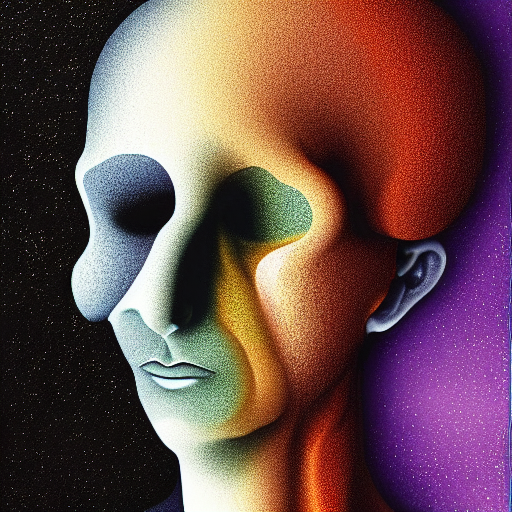

In [4]:
import numpy as np
import imageio

prompt = "My soul transcends the ashes of my body to merge with the blissful, dimensionless void. Masterpiece by Anton Wiehe"
with autocast("cuda"):
    out = pipe(prompt, output_type="latent", use_safety=False,
                        num_inference_steps=50, guidance_scale=22.0, seed=0,
                        width=512, height=512, start_img=None,
                        )
    masterpiece_latent = out["sample"][0] 
    masterpiece_latent_transition = out["latents"]
    
    
    with torch.inference_mode():
        masterpiece_image = pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="pil")[0]
    with torch.inference_mode():
         masterpiece_torch= pipe.decode_image(masterpiece_latent.unsqueeze(0), output_type="torch")
masterpiece_image

0it [00:00, ?it/s]

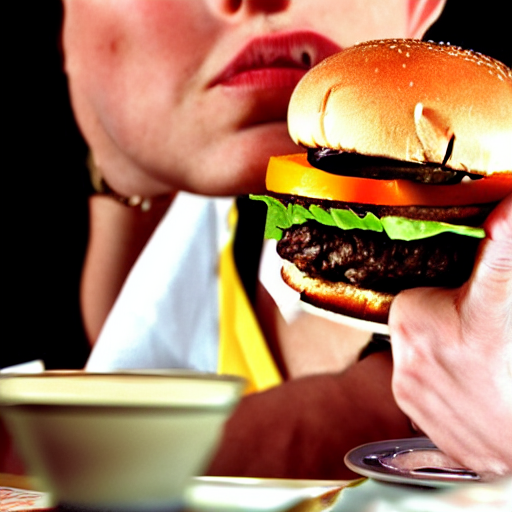

In [5]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger. Stock photo. Flickr", num_inference_steps=20, 
                    use_safety=False,
                    guidance_scale=10, seed=0, start_img=None)["sample"][0]
image

In [10]:
len(embeddings)

388

0it [00:00, ?it/s]

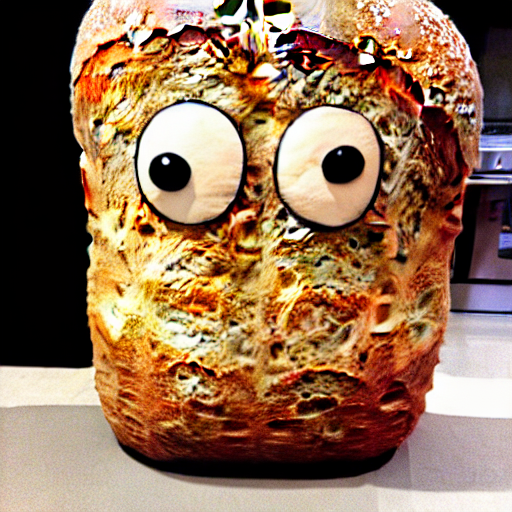

0it [00:00, ?it/s]

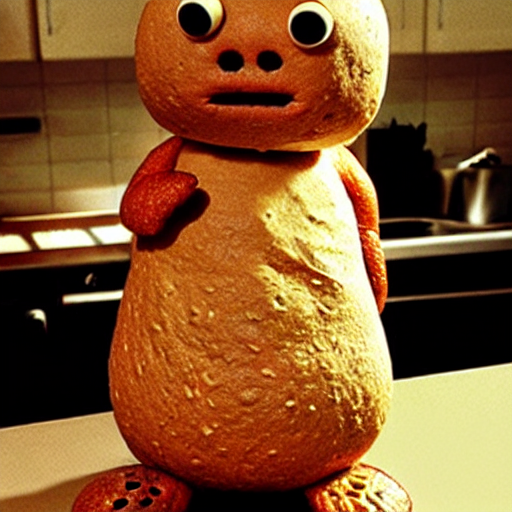

0it [00:00, ?it/s]

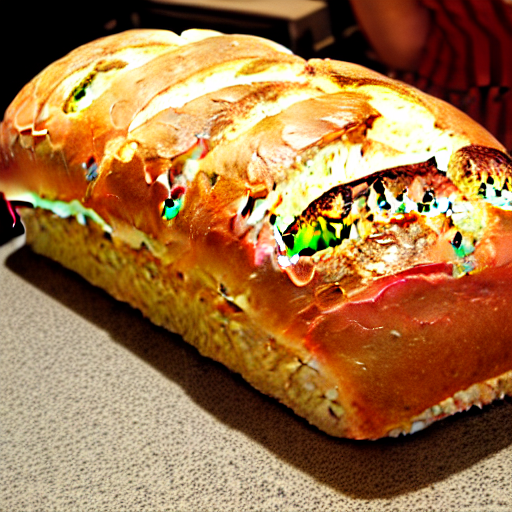

0it [00:00, ?it/s]

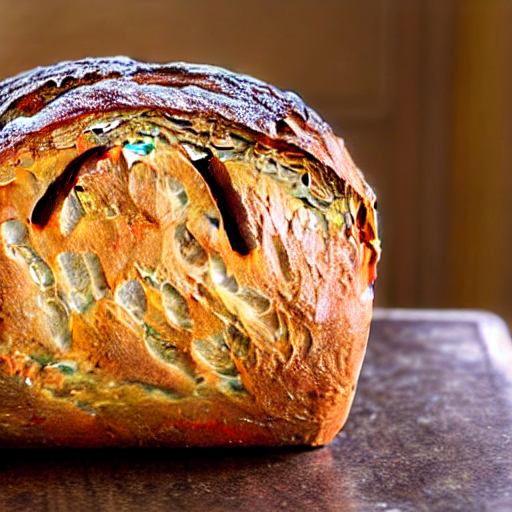

0it [00:00, ?it/s]

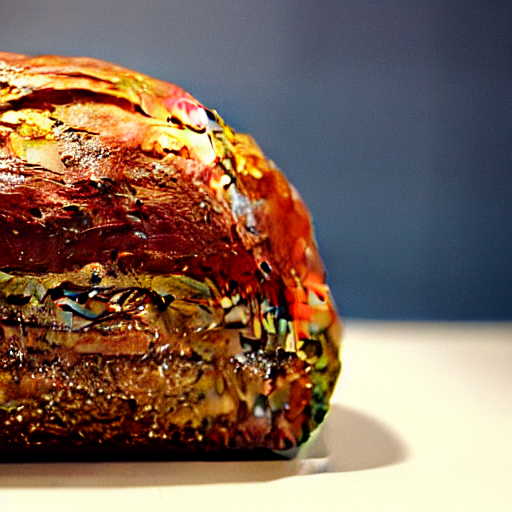

0it [00:00, ?it/s]

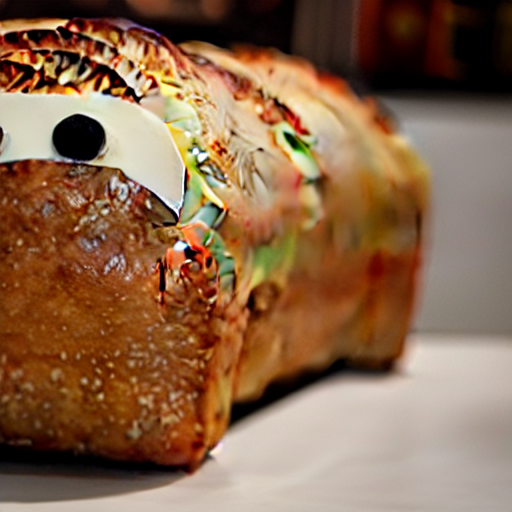

0it [00:00, ?it/s]

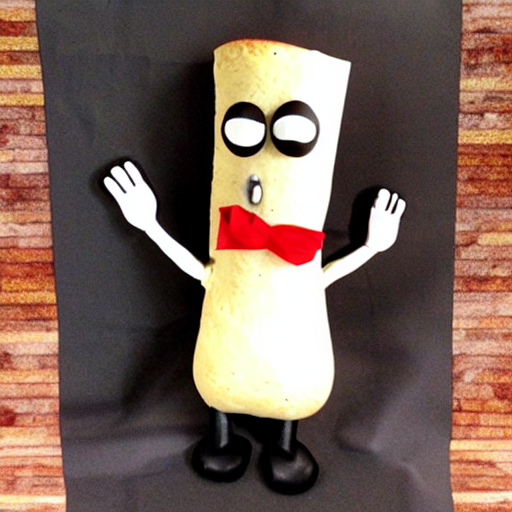

0it [00:00, ?it/s]

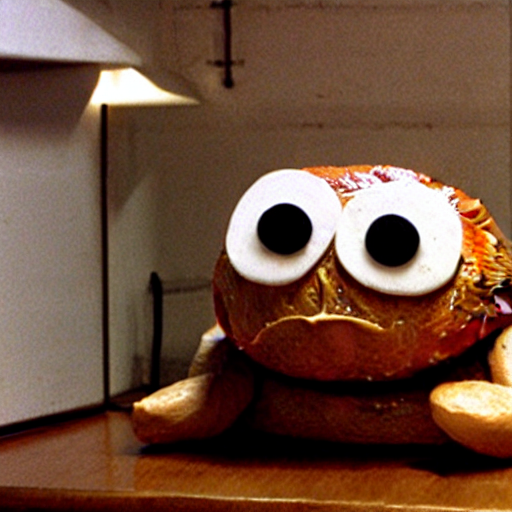

0it [00:00, ?it/s]

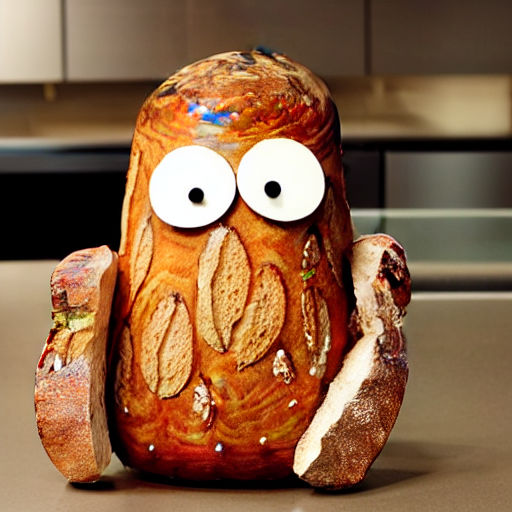

0it [00:00, ?it/s]

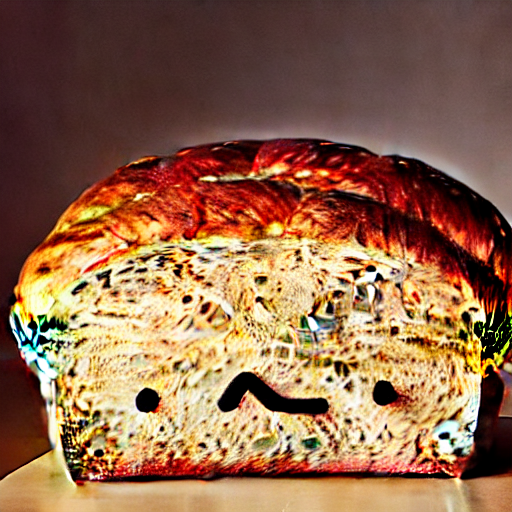

In [140]:

bernd_2 = "Bernd the bread is a depressed loaf of pullman bread with hands."

seeds = range(10)

for seed in seeds:
    with autocast("cuda"):
        image = pipe(prompt=bernd_2,
                     num_inference_steps=30, 
                        use_safety=False,
                        guidance_scale=15,

                     seed=seed ** 3, start_img=None)["sample"][0]
    image.show()

0it [00:00, ?it/s]

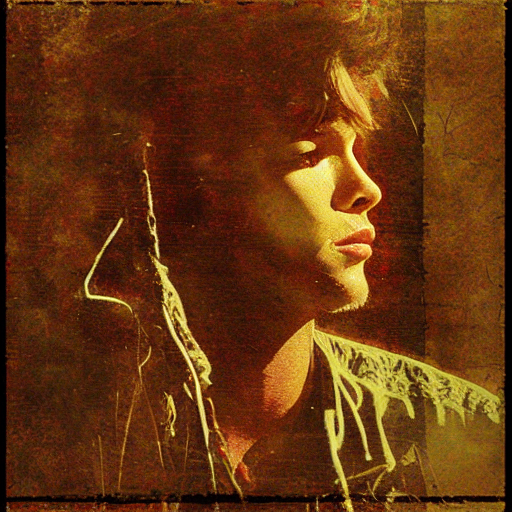

In [13]:
embeddings = torch.load("/raid/8wiehe/tmp/ema_encodings.pt")
with autocast("cuda"):
    embed_image = pipe(text_embeddings=embeddings[0][0].cuda(),
                 num_inference_steps=12, 
                    use_safety=False,
                    guidance_scale=10, seed=1, start_img=None)["sample"][0]
image

In [20]:
# TODO: how to to img2img with only very few steps???

In [21]:
# TODO: Color consistency loss!

In [22]:
import gc
torch.cuda.empty_cache()
gc.collect()

71

In [23]:
def entropyLoss(residual):
   # residual.shape[0] -> batch size
   # residual.shape[1] -> Number of channels
   # residual.shape[2] -> Width
   # residual.shape[3] -> Height
    entropy = torch.zeros(residual.shape[0],1, requires_grad=False).cuda()
    imageSize = float(residual.shape[1]*residual.shape[2]*residual.shape[3])
    for i in range(0,residual.shape[0]): #loop over batch
        res = residual[i].data.flatten(start_dim=0)# * 255)#.round()
        _, counts=torch.unique(res , dim=0,return_counts=True) #flatt tensor and compute the unique values
        p=(counts)/imageSize #compute the 
        entropy[i] = torch.sum(p* torch.log2(p))*-1
    return entropy.mean()# counts
# not differentiable! 
# torch.histc would be even better but is also not differentiable...
grad_img = img_torch.float()
grad_img.requires_grad = True

entropyLoss(grad_img), entropyLoss(torch.rand_like(img_torch.float()))

NameError: name 'img_torch' is not defined

In [24]:
torch.histc(grad_img.flatten()).mean()

NameError: name 'grad_img' is not defined

In [25]:
out = entropyLoss(img_torch.float())

NameError: name 'img_torch' is not defined

In [26]:
out[1].shape

KeyError: 1

In [27]:
def calc_entropy(input_tensor):
    lsm = torch.nn.LogSoftmax()
    log_probs = lsm(input_tensor)
    probs = torch.exp(log_probs)
    p_log_p = log_probs * probs
    entropy = -p_log_p.mean()
    return entropy
calc_entropy(img_torch.float()), calc_entropy(torch.rand_like(img_torch.float()))

NameError: name 'img_torch' is not defined

In [28]:
from torch.distributions import Categorical, ContinuousBernoulli

p_tensor = img_torch.float().squeeze().reshape(-1)
m = ContinuousBernoulli(p_tensor)
ent = m.entropy()
print(ent.shape, ent.mean(), ent)

NameError: name 'img_torch' is not defined

In [29]:
p_tensor = torch.tensor([0, 1])
entropy2 = Categorical(probs = p_tensor).entropy()
entropy2

tensor(1.1921e-07)

In [14]:
import torch.nn.functional as F

def spherical_dist_loss(x: torch.Tensor, y: torch.Tensor):
    x = F.normalize(x, dim=-1)
    y = F.normalize(y, dim=-1)
    out = torch.norm(x - y, dim=-1)
    out = torch.arcsin(out / 2)
    out = (out ** 2) * 2
    return out

In [15]:
import matplotlib.pyplot as plt
def plot_latents(latents, show=True):
    latents = latents.cpu()
    for channel in latents:
        vals = channel.flatten()
        plt.hist(vals.numpy(), bins=20)
    if show:
        plt.show()
    import io 
    from PIL import Image
    with io.BytesIO() as img_buf:
        plt.savefig(img_buf, format='png')
        im = Image.open(img_buf)
    return im

def plot_color_hist(img):
    fig, axs = plt.subplots(3, 1)
    to_tens = T.ToTensor()
    axs[0].hist(to_tens(img)[0].flatten().numpy().tolist(), bins=100, color="red")
    axs[1].hist(to_tens(img)[1].flatten().numpy().tolist(), bins=100, color="green")
    p = axs[2].hist(to_tens(img).flatten().numpy().tolist(), bins=100, color="blue")
    plt.show()

In [16]:
# TODO: loss for differentiable histogram??

# Loss for contrast should be checked! - does not seem to work or needs to be replaced with histogram-based loss

# check if we can reduce contrast instead of doing match_histograms

# can we adjust certain parameters based off histogram divergence? img2img strength?


# carefully check stochastic encode of Defusion!!! 
#https://colab.research.google.com/github/deforum/stable-diffusion/blob/main/Deforum_Stable_Diffusion.ipynb#scrollTo=81qmVZbrm4uu
# are we really doing the same!?

In [99]:
use_torch_img = True
num_inference_steps = 22

# callback params
noise_strength_before_encode = 0.002
lpips_lr = 5 # 150 leads to artefact
lpips_frequency = 10 #10

img2img_strength = 0.6 #  below 0.7 the background tends to converge to a uniform color

contrast_lr = 10 #100
normal_dist_lr = 0 #10 # 100 leads to grey
match_histograms = 1

# noise params
num_points = 50
num_noise = 50

do_random_walk = False
walk_strength = 3
walk_barrier = 3
walk_randomize = 0.6

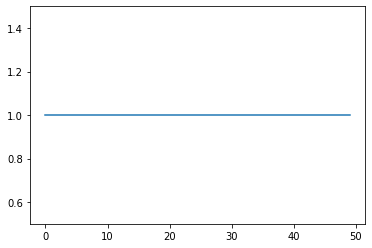

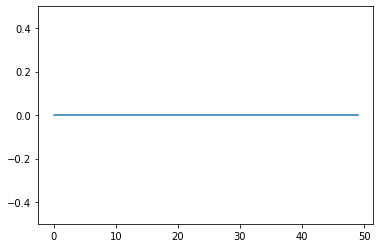

In [100]:
if num_noise > 0 or do_random_walk:
    if do_random_walk:
        start_noise = pipe.sample_noise(512, 512).cpu()


        noise_direction = torch.randn_like(start_noise) * walk_strength
        noises = []
        noise = start_noise
        for i in range(num_points):
            noise += noise_direction

            # re-randomize
            rerandomize_mask = torch.rand_like(noise) > walk_randomize
            noise_direction[rerandomize_mask] = torch.randn_like(noise_direction[rerandomize_mask]) * walk_strength

            # invert noise direction if abs val larger than walk_barrier and direction will make it larger
            pos_inv_mask = (noise > walk_barrier) & (noise_direction > 0)
            neg_inv_mask = (noise < -walk_barrier) & (noise_direction < 0)
            inv_mask = pos_inv_mask | neg_inv_mask
            noise_direction[inv_mask] *= -1

            # norm noise
            #noise = (noise - noise.mean()) / noise.std()
            noises.append(noise.clone())

    else:
        # create noise
        noises = [pipe.sample_noise(512, 512).cpu() for _ in range(num_noise)]
        # makes sure mean is zero
        noises = [n - n.mean() for n in noises]
        # make sure their standard deviation is 1
        noises = [n / n.std() for n in noises]
        import sys
        sys.path.append("../mus2vid")
        from mus2vid.math_utils import interp1d

        if num_noise == 1:
            noises = noises * num_points
        elif num_noise == num_points:
            noises = noises
        else:
            noises = interp1d(noises, num_points, use_slerp=1)


    # makes sure mean is zero
    noises = [n - n.mean() for n in noises]
    # make sure their standard deviation is 1
    noises = [n / n.std() for n in noises]


    import matplotlib.pyplot as plt
    plt.plot([n.std() for n in noises])
    plt.ylim(0.5, 1.5)
    plt.show()
    plt.plot([n.mean() for n in noises])
    plt.ylim(-0.5, .5)
    plt.show()
else:
    noises = [None] * num_points


0.011338448


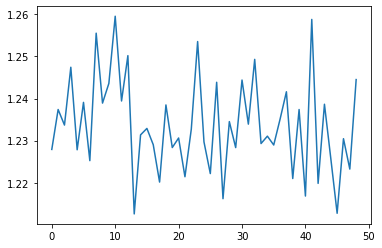

In [101]:
# calculate spherical distance between noise points - ideally it is uniform
dists = [spherical_dist_loss(noises[i].flatten(), noises[i+1].flatten()) for i in range(len(noises) - 1)]
print(np.std(dists))
plt.plot(dists)

0.011338448


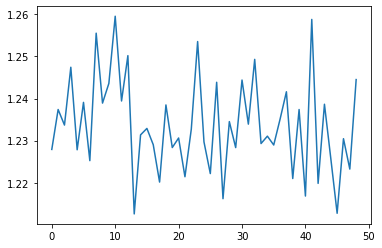

In [102]:
# calculate spherical distance between noise points - ideally it is uniform
dists = [spherical_dist_loss(noises[i].flatten(), noises[i+1].flatten()) for i in range(len(noises) - 1)]
print(np.std(dists))
plt.plot(dists)

In [103]:
dists[0].shape

torch.Size([])

In [104]:
import umap
mapper = umap.UMAP(n_components=2)
flat_noises = [n.flatten().cpu().numpy() for n in noises]
labels = mapper.fit_transform(flat_noises)

<AxesSubplot:>

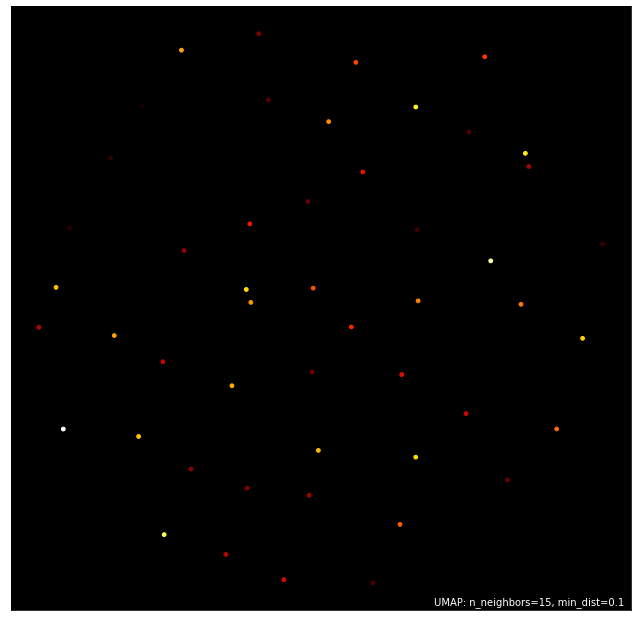

In [105]:
import umap.plot
umap.plot.points(mapper, values=np.array(range(len(flat_noises))), theme="fire")

In [106]:
def total_variation_loss(img):
    bs_img, c_img, h_img, w_img = img.size()
    tv_h = torch.pow(img[:,:,1:,:]-img[:,:,:-1,:], 2).sum()
    tv_w = torch.pow(img[:,:,:,1:]-img[:,:,:,:-1], 2).sum()
    return (tv_h+tv_w) / (bs_img*c_img*h_img*w_img)

0it [00:00, ?it/s]

0 tensor(-6.6900) tensor(6.4098) tensor(-0.0472) tensor(0.7617) tensor(0.3002)
TV loss:  tensor(0.0161)


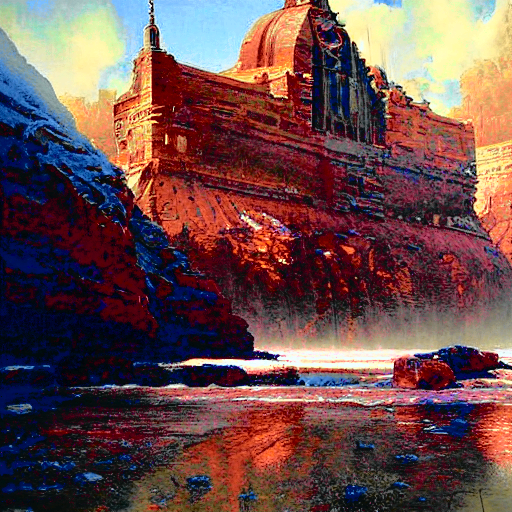

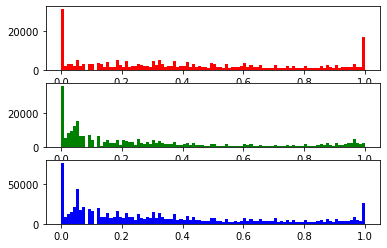

0it [00:00, ?it/s]

1 tensor(-6.8306) tensor(4.3279) tensor(-0.2625) tensor(0.8043) tensor(0.3009)
TV loss:  tensor(0.0113)


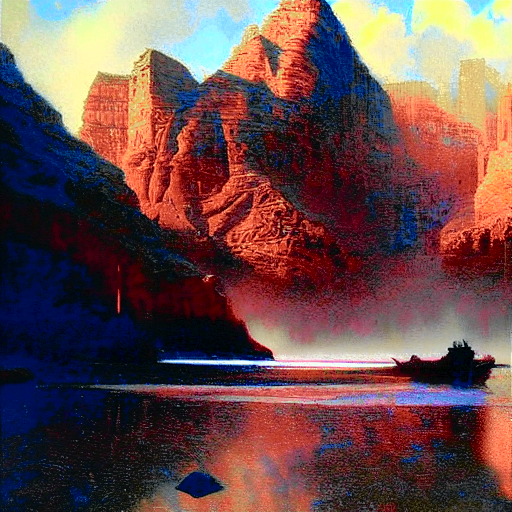

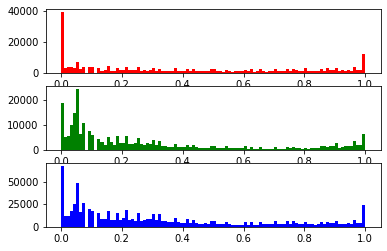

0it [00:00, ?it/s]

2 tensor(-4.4045) tensor(4.1378) tensor(-0.2778) tensor(0.8658) tensor(0.2985)
TV loss:  tensor(0.0094)


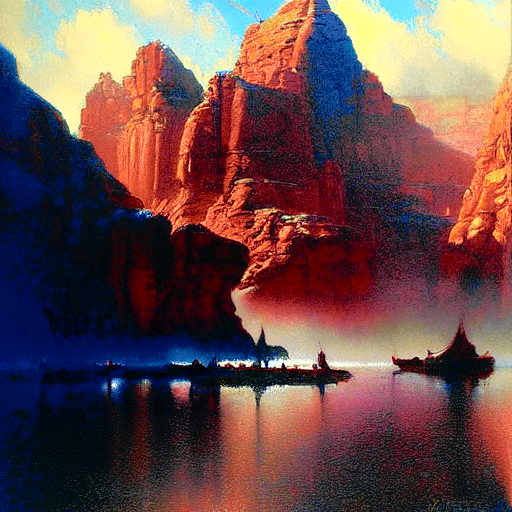

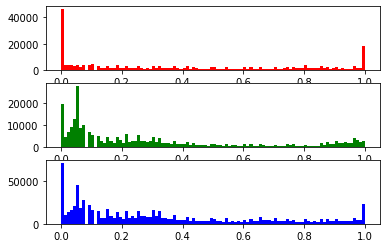

0it [00:00, ?it/s]

3 tensor(-3.1133) tensor(4.1693) tensor(-0.2839) tensor(0.9042) tensor(0.3012)
TV loss:  tensor(0.0094)


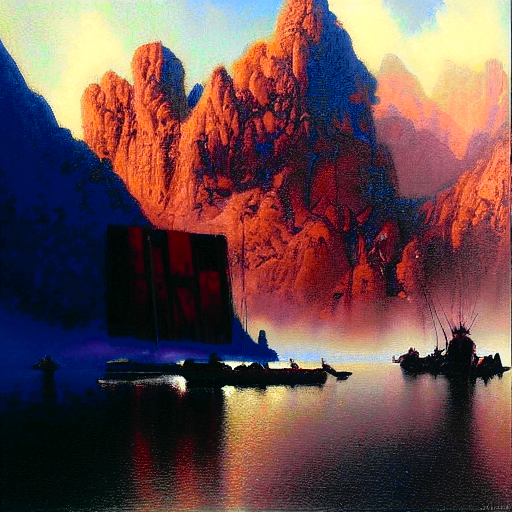

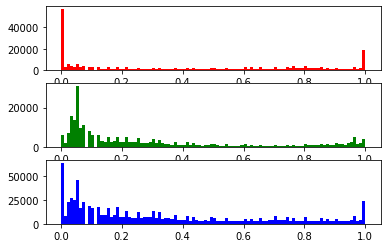

0it [00:00, ?it/s]

4 tensor(-3.3299) tensor(4.6287) tensor(-0.2595) tensor(0.9820) tensor(0.3032)
TV loss:  tensor(0.0069)


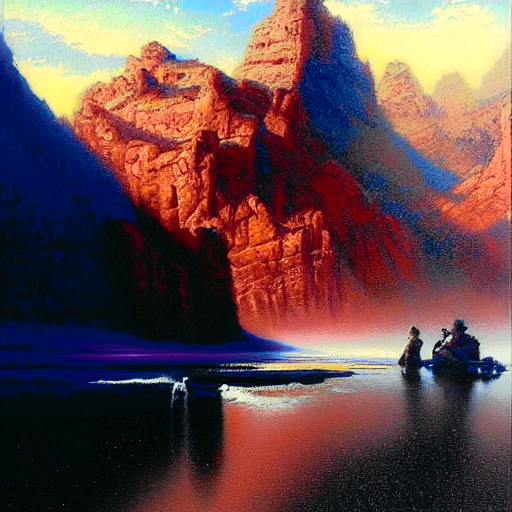

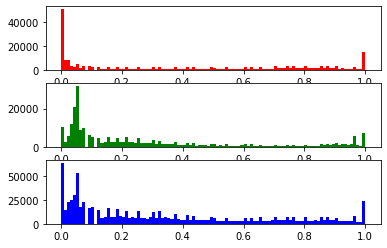

0it [00:00, ?it/s]

5 tensor(-3.9443) tensor(3.7000) tensor(-0.2545) tensor(0.9668) tensor(0.3033)
TV loss:  tensor(0.0076)


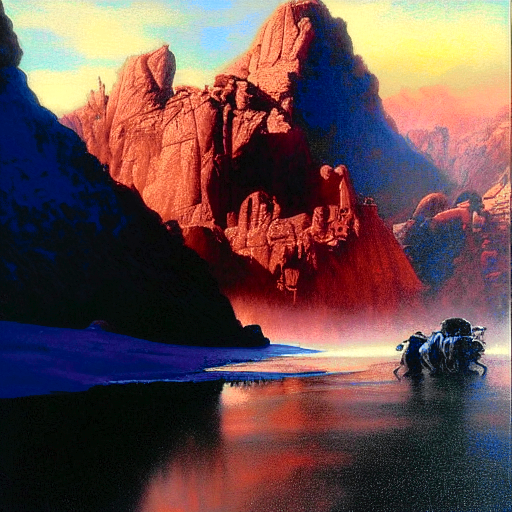

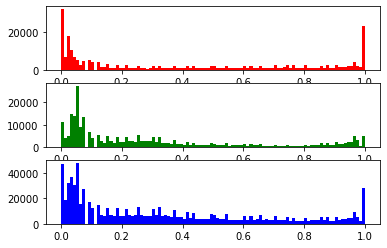

0it [00:00, ?it/s]

6 tensor(-3.0452) tensor(3.2906) tensor(-0.2516) tensor(0.9671) tensor(0.3070)
TV loss:  tensor(0.0090)


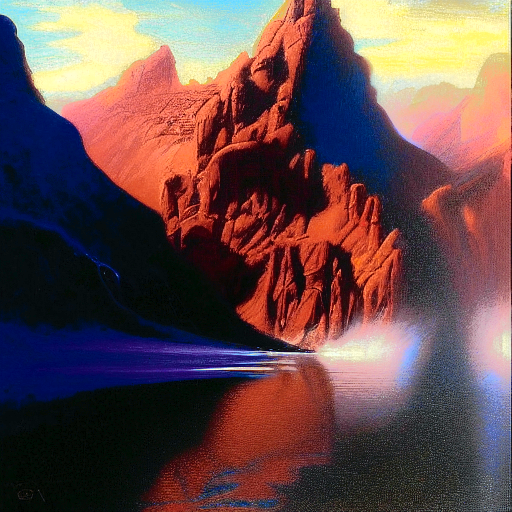

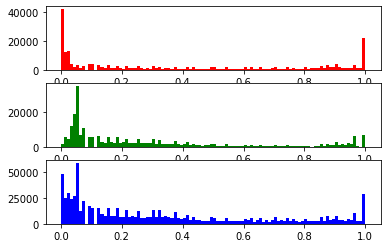

0it [00:00, ?it/s]

7 tensor(-3.3648) tensor(3.2779) tensor(-0.2466) tensor(0.9799) tensor(0.3062)
TV loss:  tensor(0.0076)


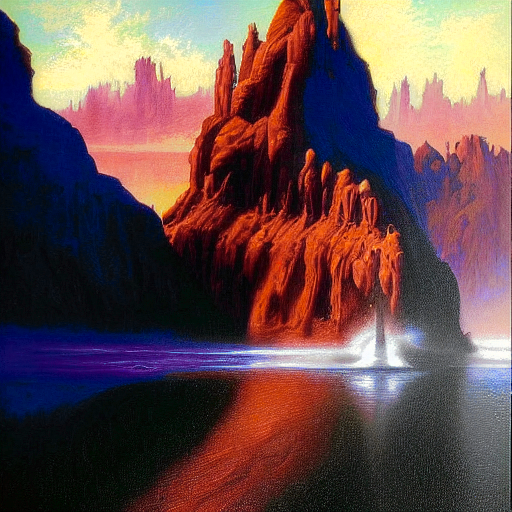

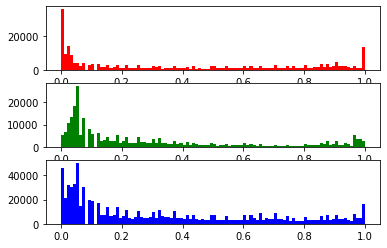

0it [00:00, ?it/s]

8 tensor(-3.9229) tensor(3.7135) tensor(-0.2534) tensor(0.9571) tensor(0.3057)
TV loss:  tensor(0.0061)


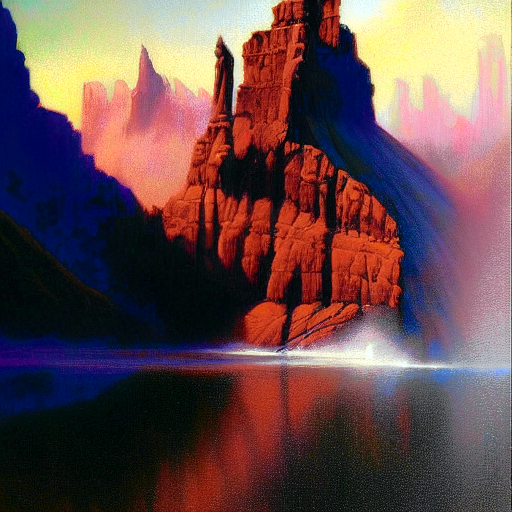

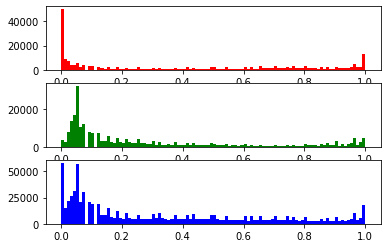

0it [00:00, ?it/s]

9 tensor(-3.1134) tensor(3.4908) tensor(-0.2602) tensor(0.9619) tensor(0.3056)
TV loss:  tensor(0.0080)


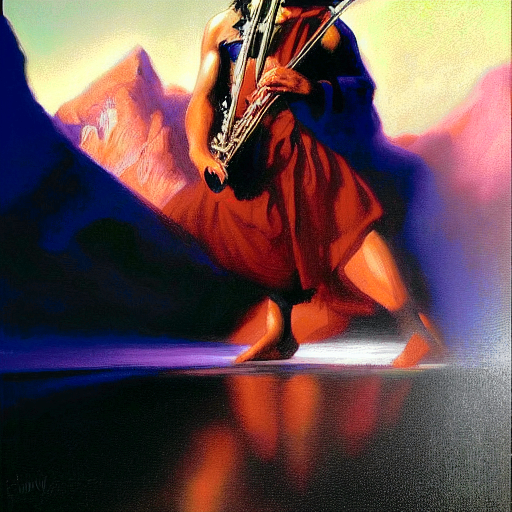

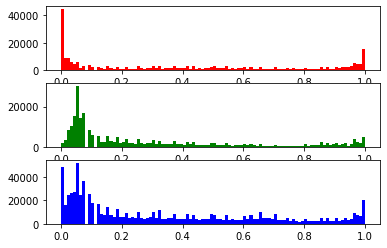

0it [00:00, ?it/s]

10 tensor(-4.0217) tensor(3.8885) tensor(-0.2516) tensor(0.9461) tensor(0.3064)
TV loss:  tensor(0.0063)


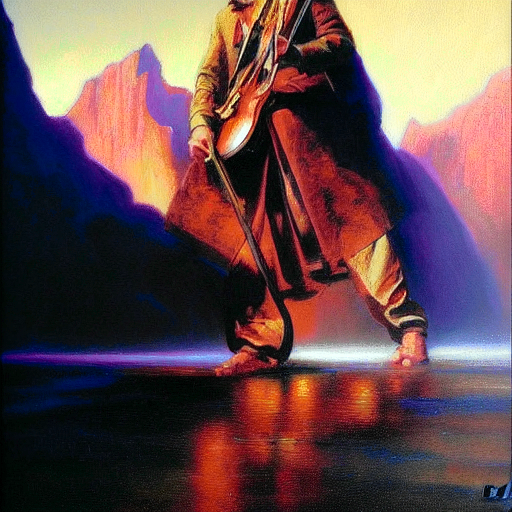

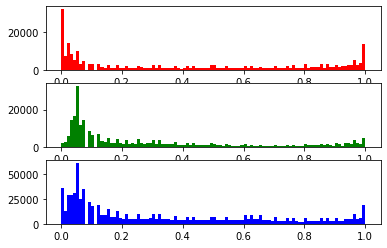

0it [00:00, ?it/s]

11 tensor(-4.5428) tensor(3.4731) tensor(-0.2658) tensor(0.9609) tensor(0.3073)
TV loss:  tensor(0.0083)


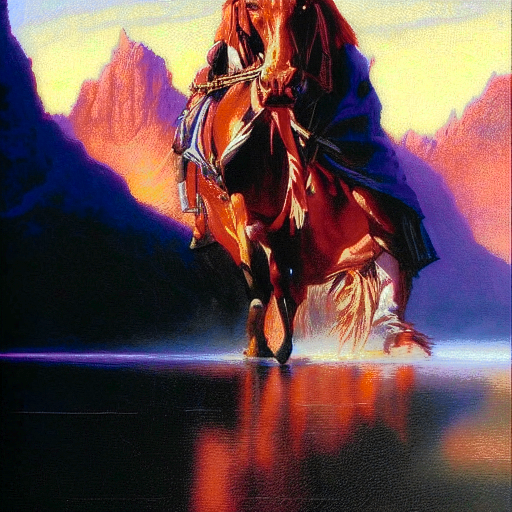

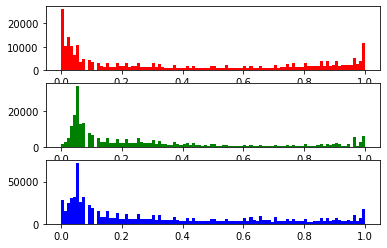

0it [00:00, ?it/s]

12 tensor(-8.2417) tensor(4.0602) tensor(-0.2660) tensor(0.9502) tensor(0.3087)
TV loss:  tensor(0.0059)


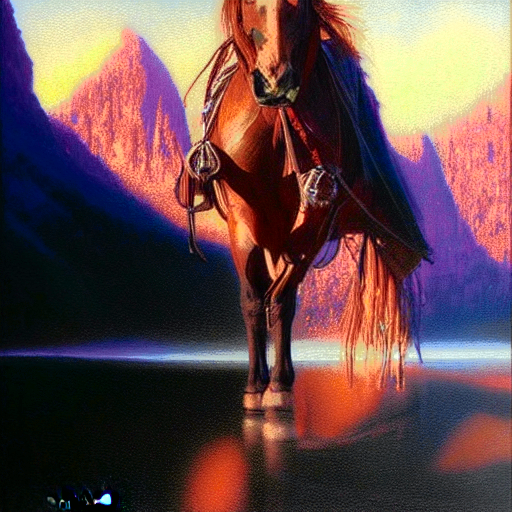

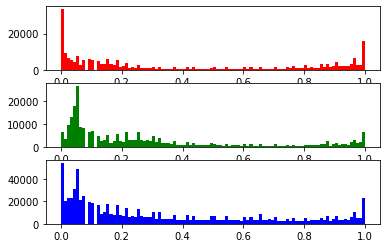

0it [00:00, ?it/s]

13 tensor(-4.3811) tensor(3.2082) tensor(-0.2707) tensor(0.9828) tensor(0.3096)
TV loss:  tensor(0.0059)


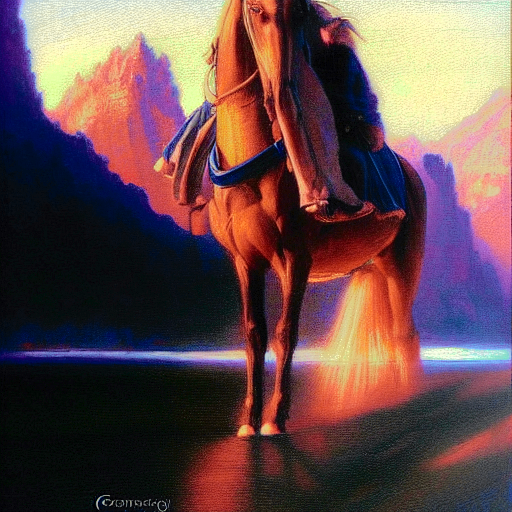

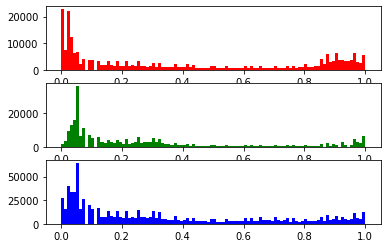

0it [00:00, ?it/s]

14 tensor(-5.0805) tensor(3.3203) tensor(-0.2794) tensor(0.9421) tensor(0.3105)
TV loss:  tensor(0.0059)


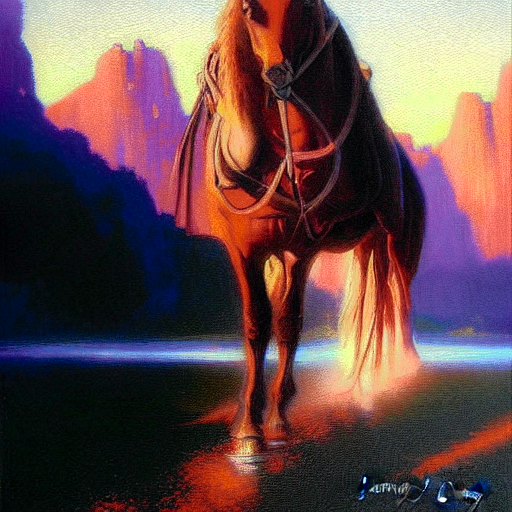

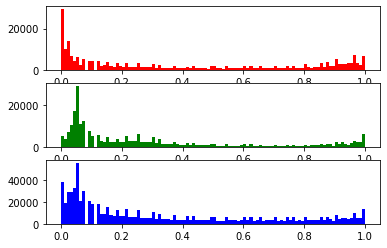

0it [00:00, ?it/s]

15 tensor(-4.6977) tensor(4.0872) tensor(-0.2766) tensor(0.9638) tensor(0.3103)
TV loss:  tensor(0.0060)


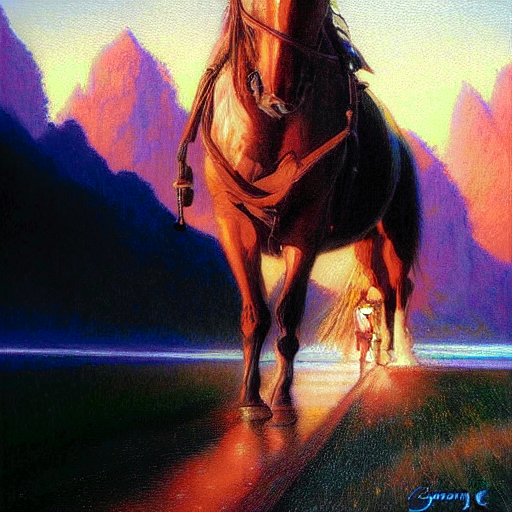

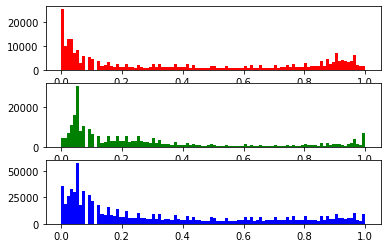

0it [00:00, ?it/s]

16 tensor(-4.0826) tensor(4.2433) tensor(-0.2522) tensor(0.9635) tensor(0.3129)
TV loss:  tensor(0.0052)


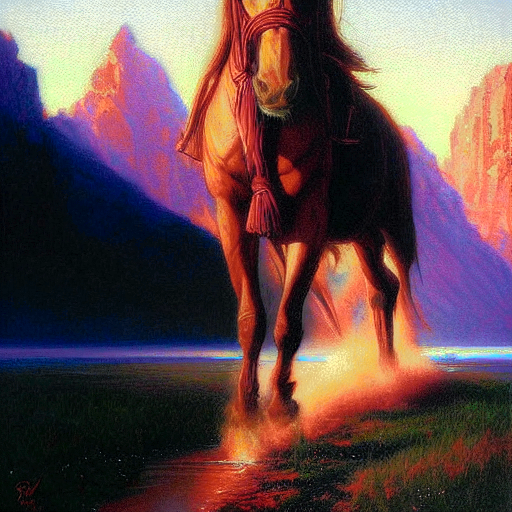

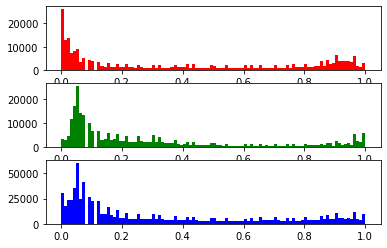

0it [00:00, ?it/s]

17 tensor(-5.0664) tensor(5.2740) tensor(-0.2599) tensor(0.9317) tensor(0.3172)
TV loss:  tensor(0.0063)


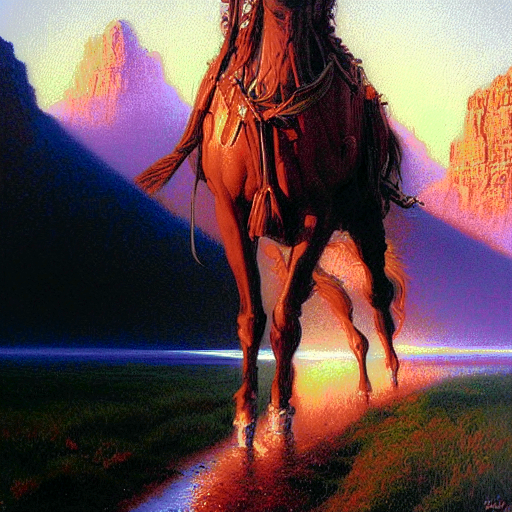

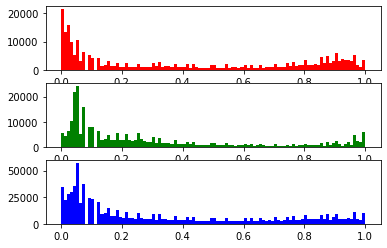

0it [00:00, ?it/s]

18 tensor(-3.1722) tensor(3.6177) tensor(-0.2578) tensor(0.9486) tensor(0.3178)
TV loss:  tensor(0.0058)


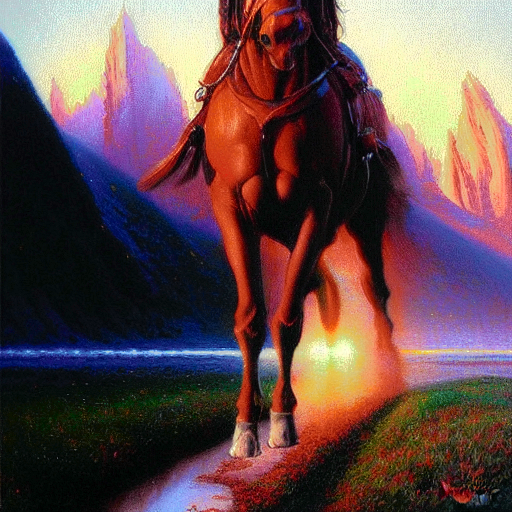

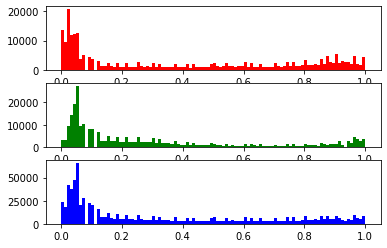

0it [00:00, ?it/s]

19 tensor(-4.5644) tensor(3.2048) tensor(-0.2643) tensor(0.9263) tensor(0.3199)
TV loss:  tensor(0.0057)


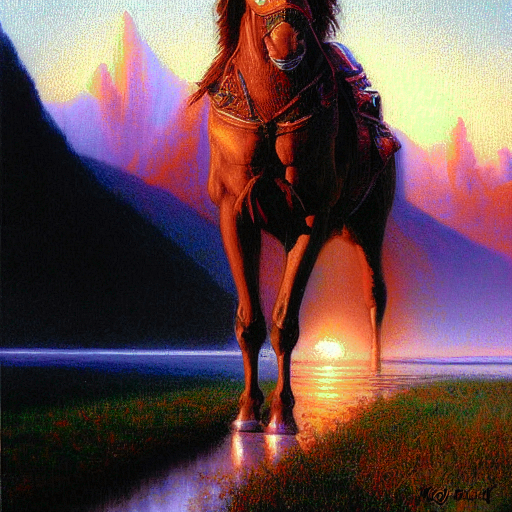

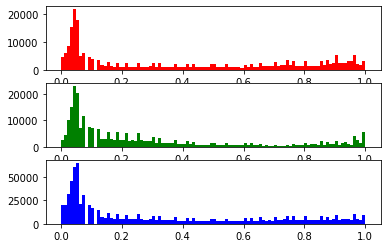

0it [00:00, ?it/s]

20 tensor(-4.0587) tensor(4.5472) tensor(-0.2584) tensor(0.9028) tensor(0.3196)
TV loss:  tensor(0.0052)


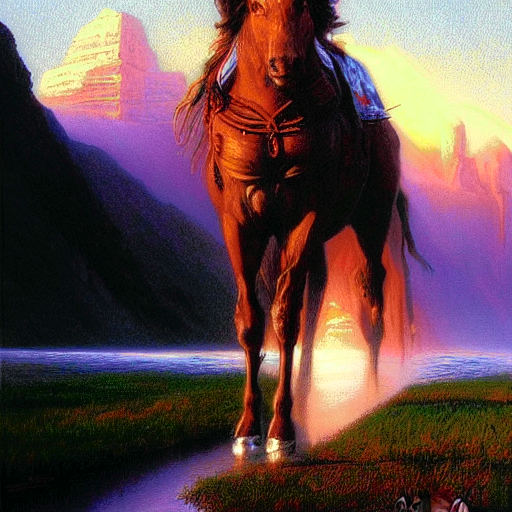

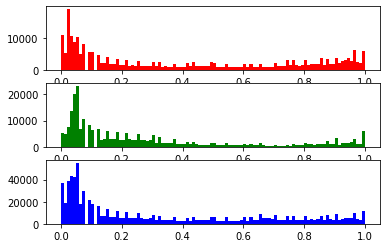

0it [00:00, ?it/s]

21 tensor(-5.8566) tensor(4.5255) tensor(-0.2402) tensor(0.9371) tensor(0.3191)
TV loss:  tensor(0.0046)


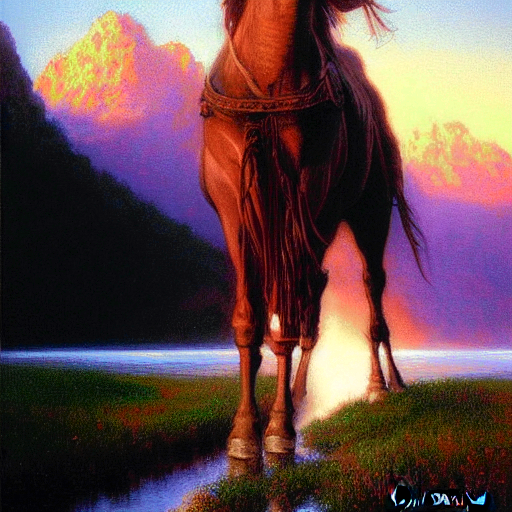

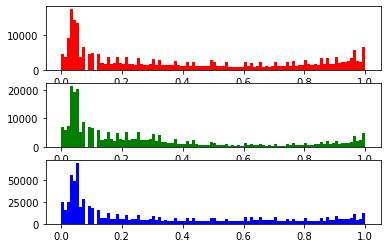

0it [00:00, ?it/s]

22 tensor(-3.8293) tensor(3.0315) tensor(-0.2637) tensor(0.9510) tensor(0.3196)
TV loss:  tensor(0.0051)


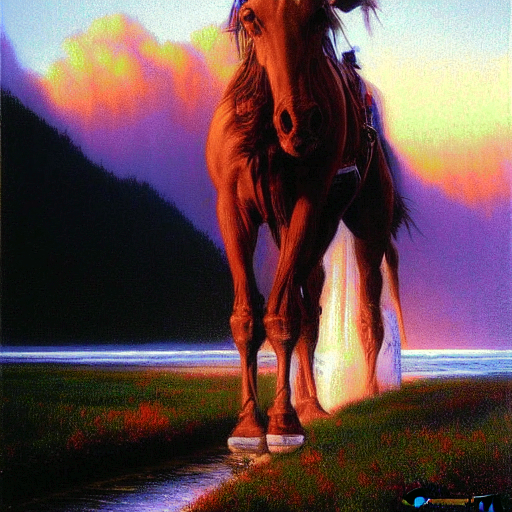

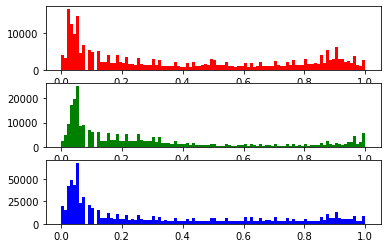

0it [00:00, ?it/s]

23 tensor(-7.0413) tensor(3.0610) tensor(-0.2480) tensor(0.9565) tensor(0.3209)
TV loss:  tensor(0.0040)


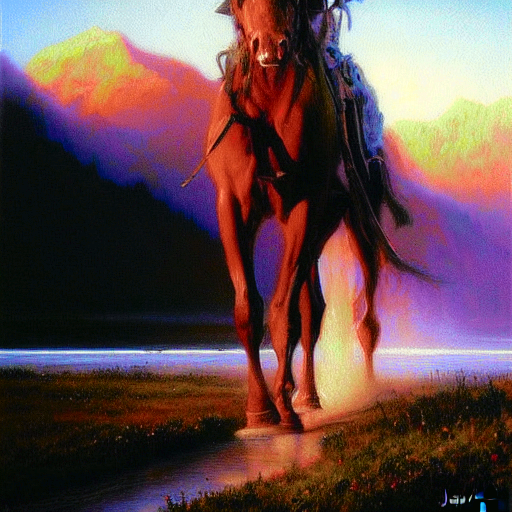

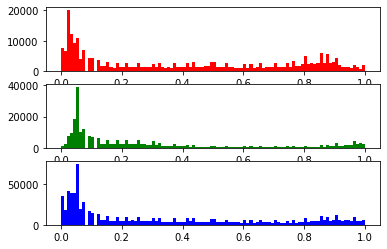

0it [00:00, ?it/s]

24 tensor(-5.2759) tensor(4.6536) tensor(-0.2264) tensor(0.9512) tensor(0.3215)
TV loss:  tensor(0.0044)


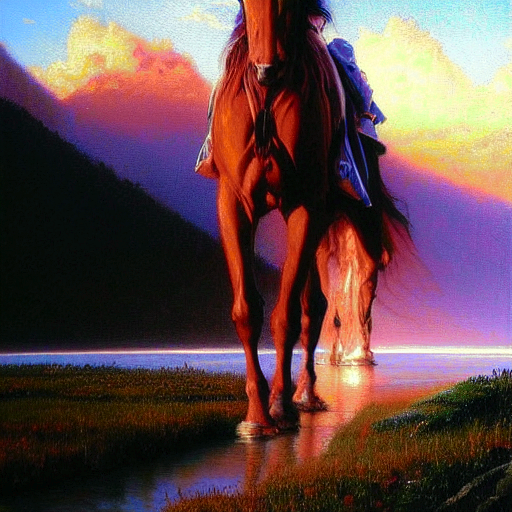

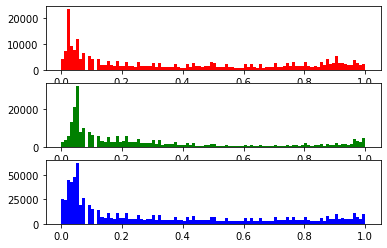

0it [00:00, ?it/s]

25 tensor(-5.3530) tensor(3.6774) tensor(-0.2181) tensor(0.9653) tensor(0.3181)
TV loss:  tensor(0.0045)


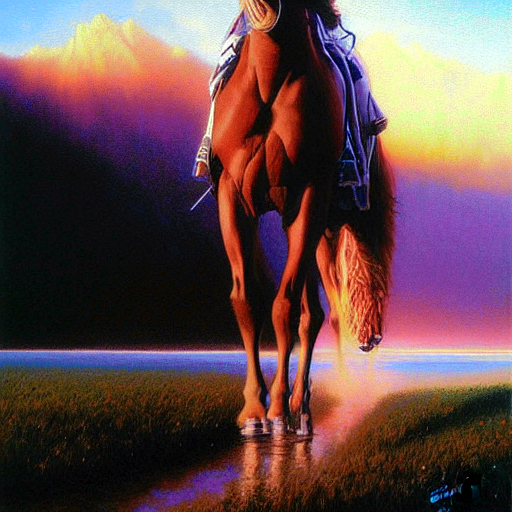

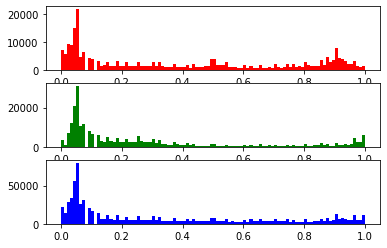

0it [00:00, ?it/s]

26 tensor(-3.2841) tensor(4.2933) tensor(-0.2320) tensor(0.9183) tensor(0.3181)
TV loss:  tensor(0.0054)


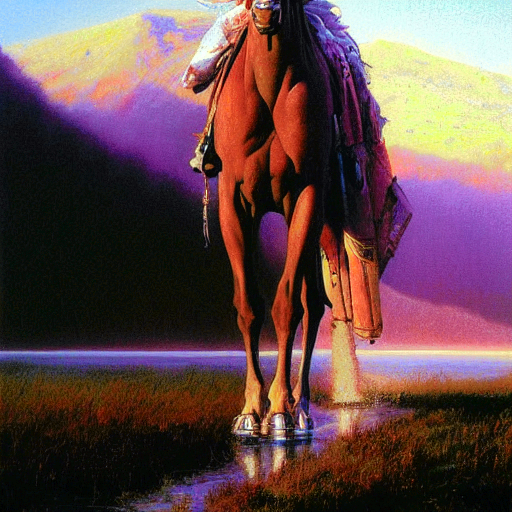

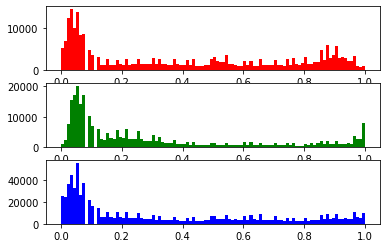

0it [00:00, ?it/s]

27 tensor(-4.2013) tensor(4.0145) tensor(-0.2228) tensor(0.9277) tensor(0.3204)
TV loss:  tensor(0.0067)


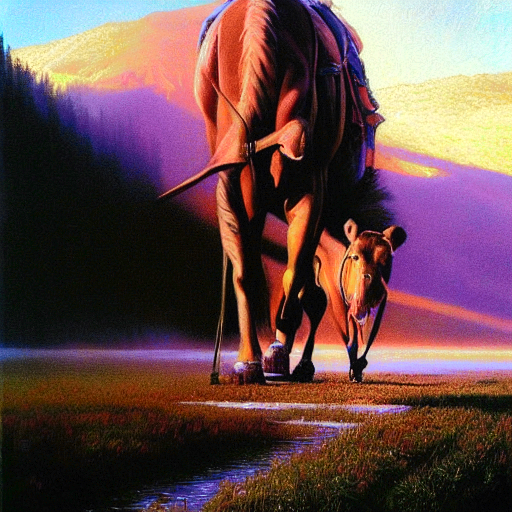

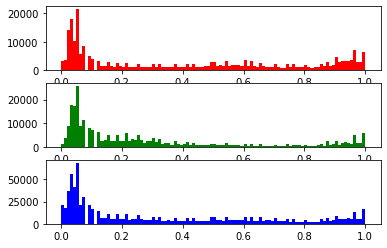

0it [00:00, ?it/s]

28 tensor(-4.3125) tensor(3.0741) tensor(-0.2379) tensor(0.9240) tensor(0.3247)
TV loss:  tensor(0.0051)


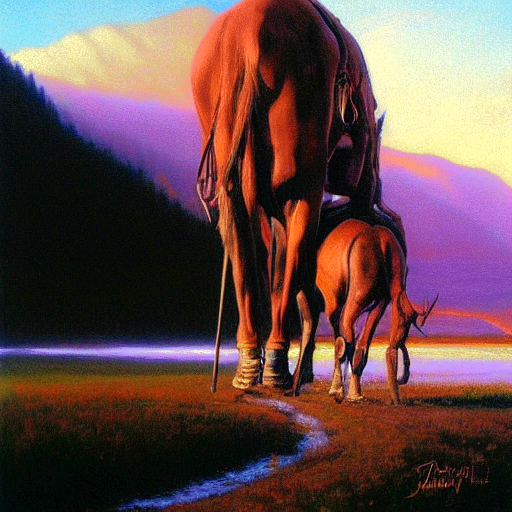

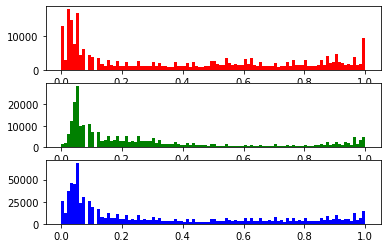

0it [00:00, ?it/s]

29 tensor(-4.6390) tensor(3.4931) tensor(-0.2383) tensor(0.9165) tensor(0.3252)
TV loss:  tensor(0.0047)


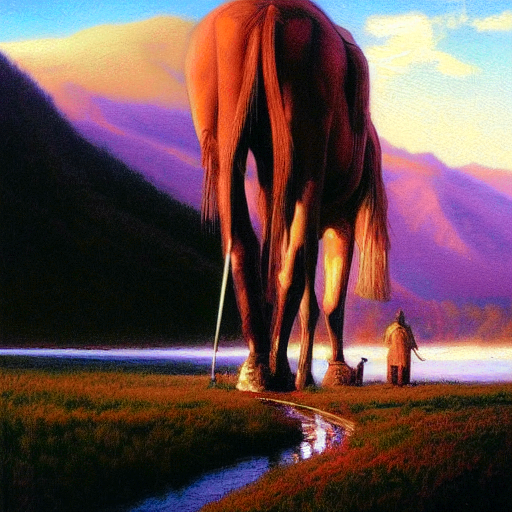

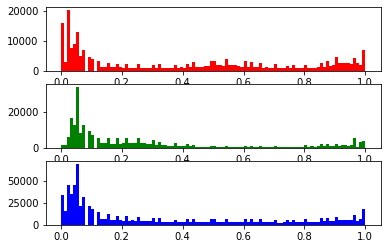

In [107]:
from PIL import Image
import skimage
import cv2
import torchvision
import sys
sys.path.append("src")
from diffusers.callbacks import create_callbacks, ContrastLoss
to_tensor = torchvision.transforms.ToTensor()

use_video_prompts = True


imgs = [masterpiece_image]
latents = [masterpiece_latent]
latent_transition_list = [masterpiece_latent_transition]

latent_cat_transitions = masterpiece_latent_transition
image_cat = masterpiece_image
img_torch = masterpiece_torch

if use_video_prompts:
    embeddings = torch.load("/raid/8wiehe/tmp/ema_encodings.pt")
    image_cat = None

for i in range(30):
    with autocast("cuda"):
        
        if use_video_prompts:
            embedding = embeddings[i][0].cuda()
            prompt = None
        else:
            embedding = None
            if i < 50:
                #prompt = "A crow eating a burger. 4K nature photography"
                prompt = "Explosion of minds. Contest-winning photography by TJ Drysdale (4K)"
        
            # prompt = "Contest-winning artwork. Masterpiece"
        # zoom
        import torchvision
        #image_cat = torchvision.transforms.functional.affine(image_cat, angle=0, translate=(0.1, 0), shear=0, scale=0.8)
        
        if image_cat is None:
            start_img = None
        elif use_torch_img:
            start_img = to_tensor(image_cat).cuda()
        else:
            start_img = image_cat
        callbacks = create_callbacks(use_lpips=lpips_lr > 0, 
                                     lpips_image=start_img,
                                     lpips_frequency=lpips_frequency,
                                     lpips_lr=lpips_lr,
                                     use_contrast=contrast_lr > 0,
                                     contrast_lr=contrast_lr,
                                     contrast_frequency=lpips_frequency,
                                    use_normal_dist=normal_dist_lr > 0,
                                    normal_dist_lr=normal_dist_lr,
                                    )
        
        
        from torchvision.transforms import ToPILImage
        #start_img_pil = to_pil(start_img.cpu().squeeze())
        #from skimage.filters import gaussian_filter
        #start_img = gaussian_filter(start_img_pil, 2, multichannel=True, mode='reflect')
        #start_img = cv2.GaussianBlur(np.array(start_img_pil), (33, 33), 2)
        
        out = pipe(prompt=prompt,#"A cat eating a burger. Stock photo. Flickr", 
                   text_embeddings=embedding,
                       num_inference_steps=num_inference_steps, 
                       output_type="latent",
                        #latents=latent_cat_transitions[-90].cuda(),
                        noise_strength_before_encode=noise_strength_before_encode, 
                        img2img_strength=img2img_strength, 
                        #noise_step=700, 
                        #t_start=15,
                        #noise_strength=0.0,
                        guidance_scale=10, 
                   seed=i * 100 + 3,
                   start_img=start_img if img2img_strength > 0 else None,
                   noise=noises[i].cuda() if noises[i] is not None else None,
                   loss_callbacks=callbacks
                  )
        latent_cat = out["sample"][0]
        #latent_cat = latent_cat.clip(-4, 4)
        latent_cat_transitions = out["latents"]
        with torch.inference_mode():
            image_cat = pipe.decode_image(latent_cat.unsqueeze(0), output_type="pil")[0]
        with torch.inference_mode():
            img_torch = pipe.decode_image(latent_cat.unsqueeze(0), output_type="torch")
            
        if match_histograms: 
            img_torch = maintain_colors(image_cat, masterpiece_image, hsv=0, lab=1, pil_input=1)
            image_cat = to_pil(img_torch.squeeze())
            
            
        print(i, latent_cat.min(), latent_cat.max(), latent_cat.mean(), latent_cat.std(), ContrastLoss()(img_torch))
        print("TV loss: ", total_variation_loss(img_torch.float()))
        #image_cat = to_pil(image_cat_tens.squeeze())
    #image_cat.resize((256, 256), Image.LANCZOS).show()
    image_cat.show()
    plot_color_hist(image_cat)
    imgs.append(image_cat)
    latents.append(latent_cat)
    latent_transition_list.append(latent_cat_transitions)
    
# TODO: taking the latent from the optimization step before works! e.g. if we first train the initial start image for 50 steps, we can take the latent from step 20 of the process as the starting 
# latent for the new optimization. For the new optimization we set the inference steps to 30 and skip the first 12 steps. we can also  do 50 inference steps and skip the first 20 steps to get to the same result
# no idea how to do this iteratively, as the second optimization only runs for 30 steps, so we cannot take the latent from the 30th latest step as it is the same one as before.


In [108]:
name = f"{num_noise}_{num_points}_{lpips_lr}_{lpips_frequency}_{num_inference_steps}_{img2img_strength}_{contrast_lr}_{normal_dist_lr}_{do_random_walk}_{walk_strength}_{walk_barrier}_{walk_randomize}_{match_histograms}_{noise_strength_before_encode}_{prompt}.mp4" 

In [109]:
os.makedirs("tmp", exist_ok=True)
path = f'tmp/{name}.gif'
if os.path.exists(path):
    path = path.replace(".gif", "_1.gif")
imageio.mimsave(path, [np.array(p) for p in imgs])

In [229]:
imgs[1].save("something_is_wrong_with_my_burger.png")

In [ ]:
import torchvision.transforms as T
to_pil = T.ToPILImage()

In [ ]:
out = maintain_colors(imgs[-1], imgs[-2], hsv=0, lab=1, pil_input=True)
to_pil(out.squeeze())

In [ ]:
def minmax(a):
    return (a - a.min()) / (a.max() - a.min())

In [ ]:
imgs[2]

In [ ]:
tens = maintain_colors(imgs[2], imgs[0], pil_input=True, lab=True).squeeze()
tens_clipped = tens.float().clip(0, 1)
pil_img = to_pil(tens_clipped)
pil_img

In [ ]:
tens.max(), tens.min()

In [ ]:
means = [l.cpu().abs().mean() for l in latents]
plt.plot(means)

In [ ]:
stds = [l.cpu().abs().std() for l in latents]
plt.plot(stds)

In [ ]:
torch.randn(4, 64, 64).mean()

In [ ]:
plot_latents(latents[0])
plot_color_hist(imgs[0])
imgs[0]

In [ ]:
plot_latents(latents[1])
plot_color_hist(imgs[1])
imgs[1].show()
with torch.autocast("cuda"):
    with torch.inference_mode():
        pipe.decode_image(latents[1].unsqueeze(0).cuda().clip(-4, 4))[0].show()

In [ ]:
plot_latents(latents[2])
plot_color_hist(imgs[2])
imgs[2]

In [ ]:
plot_latents(latents[-1])
plot_color_hist(imgs[-1])
imgs[-1].show()
with torch.autocast("cuda"):
    with torch.inference_mode():
        pipe.decode_image(latents[-1].unsqueeze(0).cuda().clip(-4, 4))[0].show()

In [ ]:
idx = 2

In [ ]:
plot_color_hist(imgs[0])

In [ ]:
len(T.ToTensor()(imgs[idx])[0].flatten().numpy().tolist()) / 512

In [ ]:
imgs[-1]

In [ ]:
latents.shape

In [ ]:
out = plot_latents(latent_transition_list[0][0].squeeze(), show=True)

In [ ]:
# normal optimization step 15 (start of other optimizations)
out = plot_latents(latent_transition_list[0][14].squeeze(), show=True)

In [ ]:
# normal optimization mid
out = plot_latents(latent_transition_list[0][30].squeeze(), show=True)

In [ ]:
# normal optimization end
out = plot_latents(latent_transition_list[0][-1].squeeze(), show=True)

In [ ]:

out = plot_latents(latent_transition_list[1][-1].squeeze(), show=True)

In [ ]:
out = plot_latents(latent_transition_list[2][0].squeeze(), show=True)

In [ ]:
out = plot_latents(latent_transition_list[-1][0].squeeze(), show=True)

In [ ]:
# TODO: check sigmas of optimization for first run and others

In [ ]:
# TODO: possiblity to get correct noise strength: use intermediate latents from last optimization run. Need to adjust num steps and sigmas (same num inference steps but increase t_start)
# we should do that anyways for mtv to avoid the need to encode the old image to get the latent to be faster
# TODO: CAREFUL, this does not work at all when applying transformations to the old image.... we need to encode the old image to get the correct latent

In [ ]:
# show latent transtion for normal optimization
plots = []
for latents_of_trans in latent_transition_list[0]:
    img = plot_latents(latents_of_trans.squeeze(), show=True)
    plots.append(img)

In [ ]:
np.array(plots[0]).shape

In [ ]:
import imageio
import os
os.makedirs("tmp", exist_ok=True)
imageio.mimsave('./tmp/latent_transition.gif', [np.array(p) for p in plots])

In [ ]:
import matplotlib.pyplot as plt
p = plt.hist(np.array(masterpiece_image)[:,:,0].flatten(), bins=100)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
p = plt.hist(np.array(imgs[1])[:,:,0].flatten(), bins=100)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
p = plt.hist(np.array(imgs[2])[:,:,0].flatten(), bins=100)
plt.show()

In [ ]:
tensor_out = maintain_colors(imgs[1], imgs[2], pil_input=True, hsv=True)
import torchvision
to_pil = torchvision.transforms.ToPILImage()
pil_img = to_pil(tensor_out.squeeze())
pil_img

In [ ]:
import matplotlib.pyplot as plt
p = plt.hist(np.array(pil_img)[:,:,0].flatten(), bins=100)
plt.show()

In [ ]:
tensor_out = maintain_colors(imgs[1], imgs[0], pil_input=True, hsv=True)
import torchvision
to_pil = torchvision.transforms.ToPILImage()
pil_img = to_pil(tensor_out.squeeze())
pil_img

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    noise_strength_before_encode=0.9, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()
for _ in range(10):
    with autocast("cuda"):
        image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                        noise_strength_before_encode=0.9, use_safety=False,
                        guidance_scale=6, seed=0, start_img=image_cat)["sample"][0]
    image_cat.show()

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    noise_strength_before_encode=0.7, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()
for _ in range(10):
    with autocast("cuda"):
        image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                        noise_strength_before_encode=0.7, use_safety=False,
                        guidance_scale=6, seed=0, start_img=image_cat)["sample"][0]
    image_cat.show()

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    noise_strength_before_encode=0.7, t_start=15, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()
for _ in range(10):
    with autocast("cuda"):
        image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                        noise_strength_before_encode=0.7, t_start=15, use_safety=False,
                        guidance_scale=6, seed=0, start_img=image_cat)["sample"][0]
    image_cat.show()

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A photo of a cat eating a burger. Realism", num_inference_steps=50, 
                    img2img_strength=0.99, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.9, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A drunk duck attacks someone in a park", num_inference_steps=50, 
                    img2img_strength=0.9, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A photo of a duck that is attacking Donald Trump", num_inference_steps=100, 
                    img2img_strength=0.9, use_safety=False,
                    guidance_scale=7.5, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A photo of a duck attacking Donald Trump in a park", num_inference_steps=100, 
                    img2img_strength=0.9, use_safety=False,
                    guidance_scale=7.5, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A photo of a duck attacking Donald Trump in a park", num_inference_steps=100, 
                    img2img_strength=0.9, use_safety=False,
                    guidance_scale=7.5, seed=0, start_img=None)["sample"][0]
image_cat.show()

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A drunk duck is attacking Donald Trump. It looks very aggressive and Trump is hurt badly", num_inference_steps=100, 
                    img2img_strength=0.9, use_safety=False,
                    guidance_scale=7.5, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()

In [ ]:
for _ in range(10):
    with autocast("cuda"):
        image_cat = pipe(prompt="A drunk duck is attacking Donald Trump. It looks very aggressive and Trump is hurt badly, num_inference_steps=50, 
                        img2img_strength=0.9, use_safety=False,
                        guidance_scale=6, seed=0, start_img=image_cat)["sample"][0]
    image_cat.show()

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.9, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image_cat.show()
for _ in range(10):
    with autocast("cuda"):
        image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                        img2img_strength=0.9, use_safety=False,
                        guidance_scale=6, seed=0, start_img=image_cat)["sample"][0]
    image_cat.show()

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.8, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
masterpiece_image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="The machine elves are laughing at us", num_inference_steps=50, 
                    img2img_strength=0.6, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="The machine elves are laughing at us", num_inference_steps=50, 
                    img2img_strength=0.8, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.8, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.7, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.8, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image.show()


In [ ]:
with autocast("cuda"):
    image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.7, use_safety=False,
image.show()
for _ in range(10):
    with autocast("cuda"):
        image_cat = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                        img2img_strength=0.7, use_safety=False,
                        guidance_scale=6, seed=0, start_img=image_cat)["sample"][0]

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=10, 
                    img2img_strength=0.7, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.6, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.5, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    cat_image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.5, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image.show()

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    img2img_strength=0.3, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    noise_step=937,
                    t_start=3,
                    use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=100, 
                    noise_strength=0.8,
                    t_start=30,
                    use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    noise_step=200,
                    t_start=40,
                    use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    noise_step=800,
                    t_start=0,
                    use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=50, 
                    noise_step=900,
                    t_start=0,
                    use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
pipe.scheduler

In [ ]:
noise_strength = 0
noise_step = 285
img2img_strength = 0.0

num_inference_steps = 50
offset = 0
batch_size = 1

with autocast("cuda"):
    with torch.inference_mode():
        latents = pipe.encode_image(masterpiece_image)
        # add noise
        noise = torch.randn_like(latents, device=pipe.device)
        if noise_strength is not None and noise_strength is not 0:
            # old method to add noise:
            noisy_latents = latents * (1 - noise_strength) + noise * noise_strength
        elif noise_step is not None and noise_step > 0:
            # now we use the scheduler to add noise
            noisy_latents = pipe.scheduler.add_noise(latents, noise, noise_step)
        elif img2img_strength is not None and img2img_strength is not 0:
            init_timestep = int(num_inference_steps * img2img_strength) + offset
            init_timestep = min(init_timestep, num_inference_steps)
            print("init_timestep:", init_timestep)
            timesteps = int(pipe.scheduler.timesteps[-init_timestep])
            timesteps = torch.tensor([timesteps] * batch_size, dtype=torch.long, device=pipe.device)
            # add noise to latents using the timesteps
            print("timesteps:", timesteps)
            noisy_latents = pipe.scheduler.add_noise(latents, noise, timesteps)
        else: 
            noisy_latents = latents
            
        decoded = pipe.decode_image(noisy_latents)[0]
decoded.show()

In [ ]:
with autocast("cuda"):
    with torch.inference_mode():
        decoded = pipe.decode_image(latents)[0]
decoded

In [ ]:
quant = torch.quantile(latents.float().abs(), 0.9)
print(quant)
clipped_latent = torch.clip(latents, -quant, quant) #/ quant
with autocast("cuda"):
    with torch.inference_mode():
        decoded = pipe.decode_image(clipped_latent)[0]
decoded

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=30, 
                    noise_step=900, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=30, 
                    noise_step=950, use_safety=False,
                    guidance_scale=6, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=30, 
                    noise_step=990, use_safety=False,
                    guidance_scale=10, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger with its paws", num_inference_steps=30, 
                    noise_step=990, use_safety=False,
                    guidance_scale=10, seed=0, start_img=masterpiece_image)["sample"][0]
image

In [ ]:
with autocast("cuda"):
    image = pipe(prompt="A cat eating a burger", num_inference_steps=30, 
                    noise_step=999, use_safety=False, dynamic_thresholding_quant=0.0001,
                    guidance_scale=6, seed=0, start_img=None)["sample"][0]
image